<a href="https://colab.research.google.com/github/rudrani-rane/Underwater-Object-Detection-And-Classification-Using-YOLOv8/blob/main/Underwater_Object_Detection_and_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os
import cv2
import yaml
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
from collections import defaultdict

In [4]:
base_dir = "/content/drive/MyDrive/archive/aquarium_pretrain"
train_img_dir = os.path.join(base_dir, "train/images")
train_lbl_dir = os.path.join(base_dir, "train/labels")
valid_img_dir = os.path.join(base_dir, "valid/images")
valid_lbl_dir = os.path.join(base_dir, "valid/labels")

In [5]:
yaml_path = os.path.join(base_dir,"data.yaml")

with open(yaml_path, 'r') as f:
    data_yaml = yaml.safe_load(f)

class_names = data_yaml['names']
num_classes = len(class_names)

print("Classes:", class_names)
print("Number of classes:", num_classes)

Classes: ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']
Number of classes: 7


<ipython-input-6-c4b1cd6fad45>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=counts, palette='viridis')


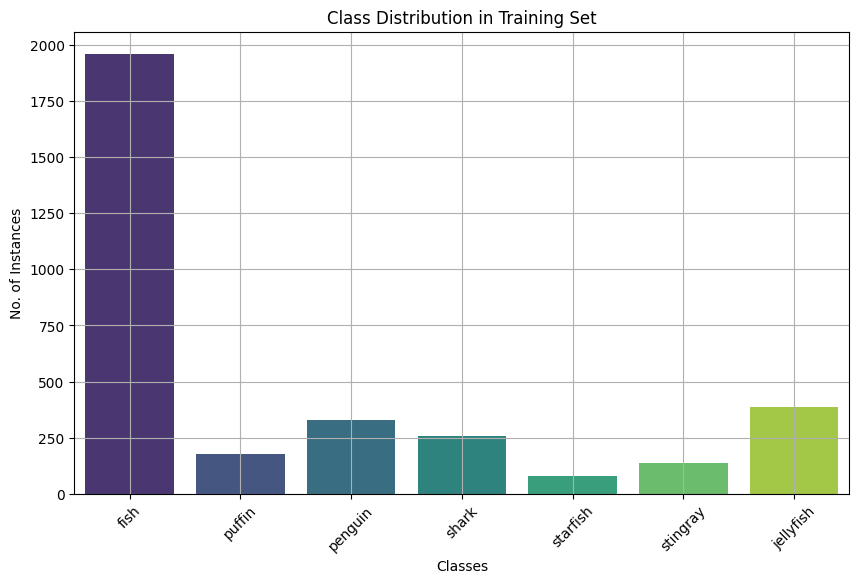

In [6]:
class_counts = defaultdict(int)
label_files = glob(os.path.join(train_lbl_dir, "*.txt"))

for label_file in label_files:
    with open(label_file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            cls_id = int(line.strip().split()[0])
            class_counts[cls_id] += 1


#Plotting the class distribution
labels = [class_names[i] for i in class_counts.keys()]
counts = list(class_counts.values())

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=counts, palette='viridis')
plt.title("Class Distribution in Training Set")
plt.ylabel("No. of Instances")
plt.xlabel("Classes")
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


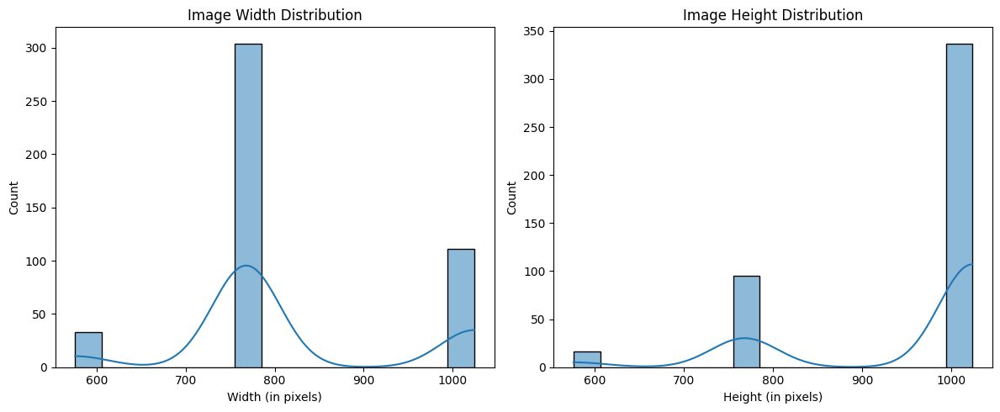

In [7]:
#Image Dimensions
img_shapes = []
for img_path in glob(os.path.join(train_img_dir, "*.jpg")):
    img = cv2.imread(img_path)
    h, w = img.shape[:2]
    img_shapes.append((w, h))

widths, heights = zip(*img_shapes)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(widths, bins=15, kde=True)
plt.title("Image Width Distribution")
plt.xlabel("Width (in pixels)")

plt.subplot(1, 2, 2)
sns.histplot(heights, bins=15, kde=True)
plt.title("Image Height Distribution")
plt.xlabel("Height (in pixels)")
plt.tight_layout()
plt.show()


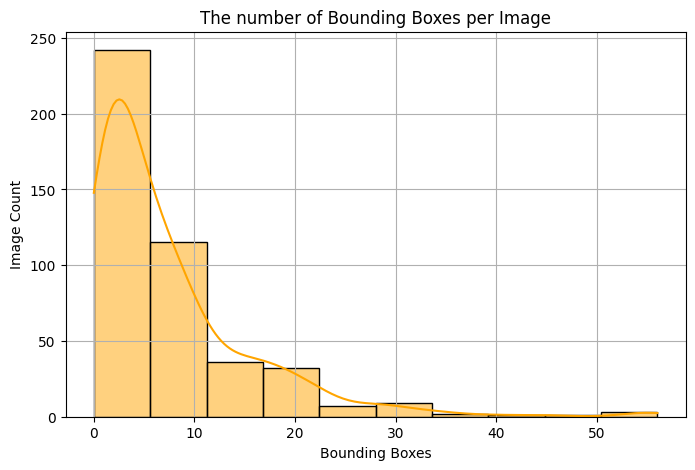

In [8]:
bbox_counts = []

for label_file in label_files:
    with open(label_file, 'r') as f:
        lines = f.readlines()
        bbox_counts.append(len(lines))

plt.figure(figsize=(8, 5))
sns.histplot(bbox_counts, bins=10, kde=True, color='orange')
plt.title("The number of Bounding Boxes per Image")
plt.xlabel("Bounding Boxes")
plt.ylabel("Image Count")
plt.grid(True)
plt.show()


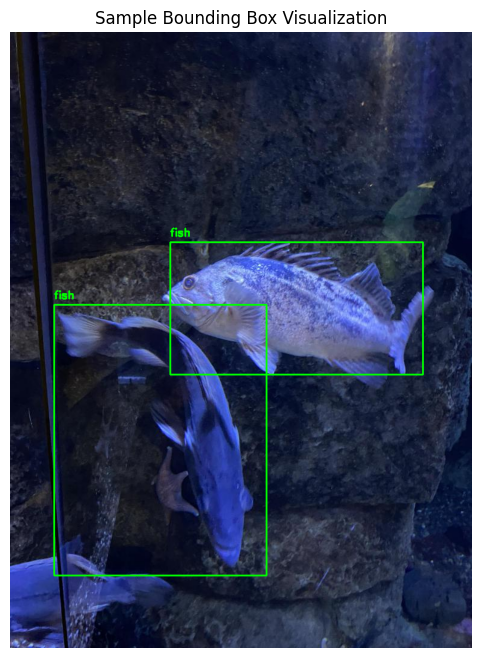

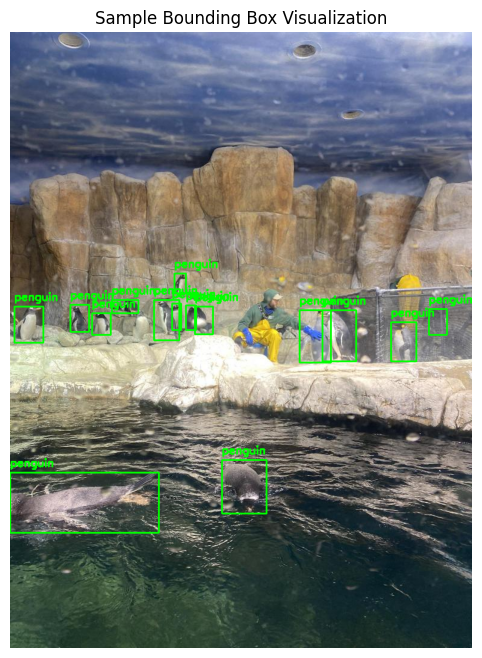

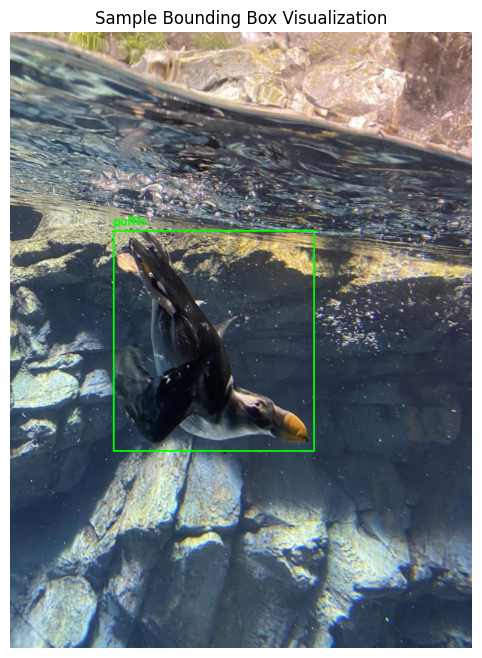

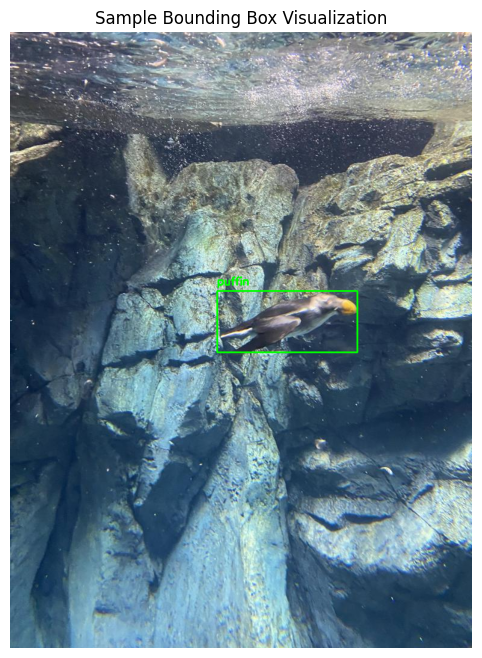

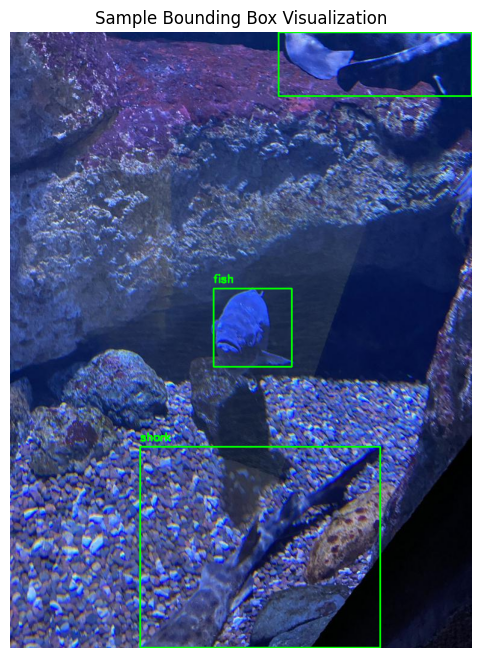

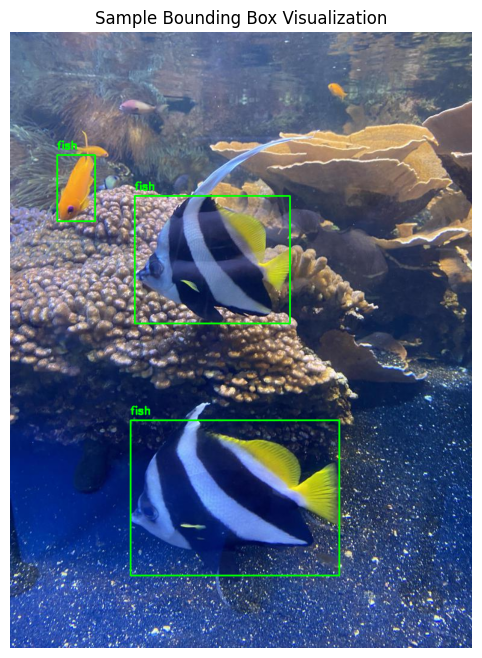

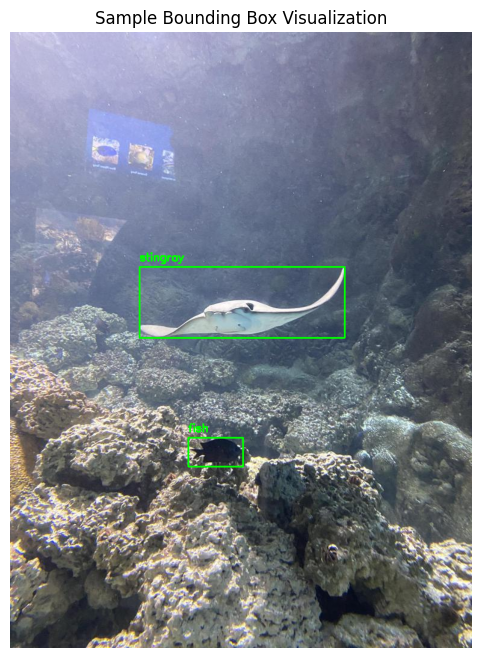

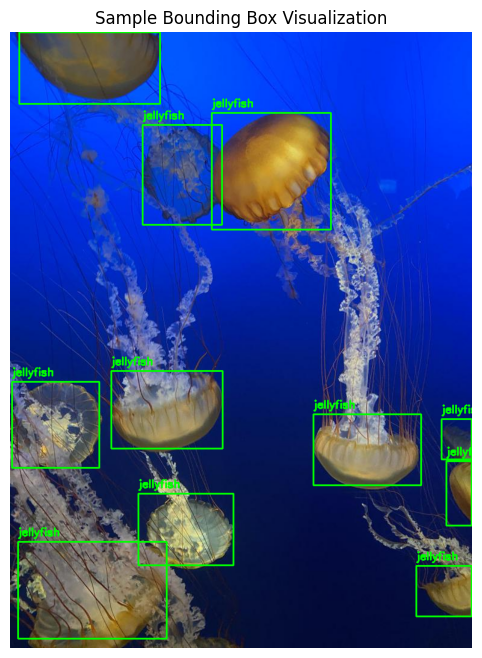

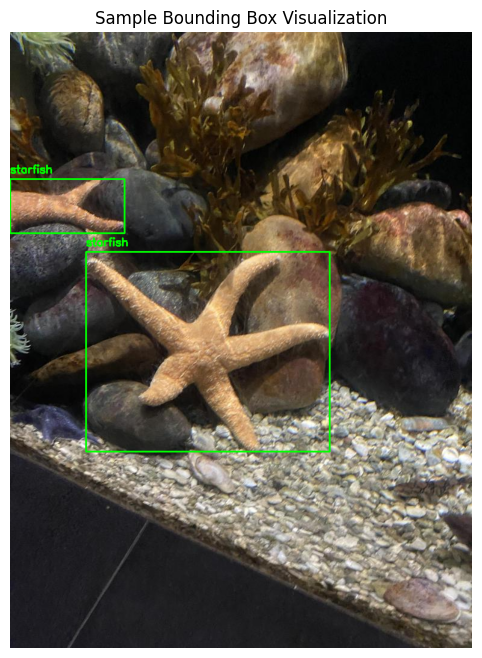

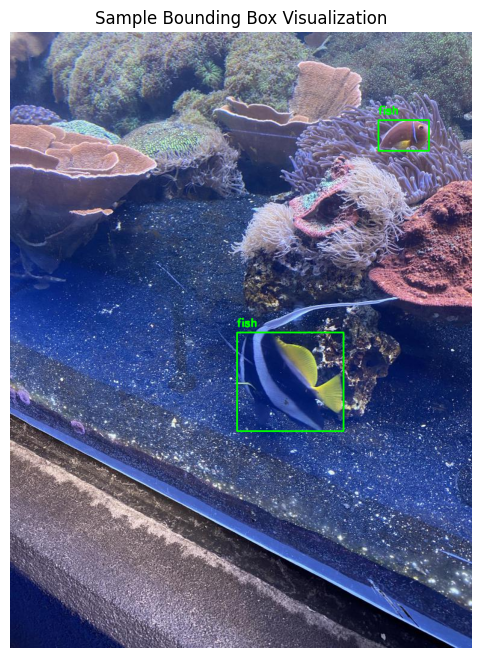

In [9]:
#Drawing bounding boxes for some samples
def draw_yolo_boxes(image_path, label_path, class_list):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w = image.shape[:2]

    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        cls, x_c, y_c, bw, bh = map(float, line.strip().split())
        cls = int(cls)
        x1 = int((x_c - bw / 2) * w)
        y1 = int((y_c - bh / 2) * h)
        x2 = int((x_c + bw / 2) * w)
        y2 = int((y_c + bh / 2) * h)

        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(image, class_list[cls], (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    return image

#Printing random samples to check if the previous bounary boxes work
import random
sample_imgs = random.sample(glob(train_img_dir + "/*.jpg"), 10)

for img_path in sample_imgs:
    base = os.path.splitext(os.path.basename(img_path))[0]
    label_path = os.path.join(train_lbl_dir, base + ".txt")

    vis = draw_yolo_boxes(img_path, label_path, class_names)
    plt.figure(figsize=(10, 8))
    plt.imshow(vis)
    plt.axis("off")
    plt.title("Sample Bounding Box Visualization")
    plt.show()


In [10]:
import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
import pandas as pd
import numpy as np
from tqdm import tqdm

# For augmentations
import albumentations as A
from albumentations.pytorch import ToTensorV2


<ipython-input-11-4a20e0f6df42>:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_classes, x='Class Name', y='Count', palette='viridis')


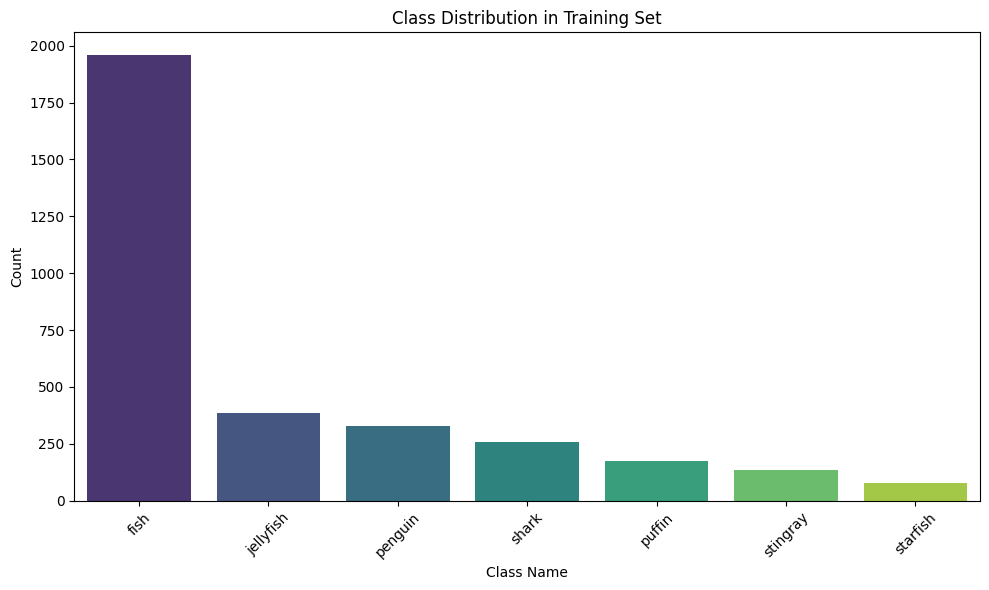

In [11]:
train_label_path = '/content/drive/MyDrive/archive/aquarium_pretrain/train/labels'
label_files = glob(os.path.join(train_label_path, '*.txt'))

class_counts = {}

# YOLO label format
for file in label_files:
    with open(file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            cls_id = int(line.split()[0])
            class_counts[cls_id] = class_counts.get(cls_id, 0) + 1

#Loading class names as given in the data.yaml file
import yaml
with open('/content/drive/MyDrive/archive/aquarium_pretrain/data.yaml', 'r') as f:
    data_yaml = yaml.safe_load(f)
class_names = data_yaml['names']

#Creating a DataFrame
df_classes = pd.DataFrame({
    'Class ID': list(class_counts.keys()),
    'Count': list(class_counts.values()),
    'Class Name': [class_names[c] for c in class_counts.keys()]
}).sort_values('Count', ascending=False)


plt.figure(figsize=(10,6))
sns.barplot(data=df_classes, x='Class Name', y='Count', palette='viridis')
plt.title("Class Distribution in Training Set")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


100%|██████████| 300/300 [00:02<00:00, 114.14it/s]


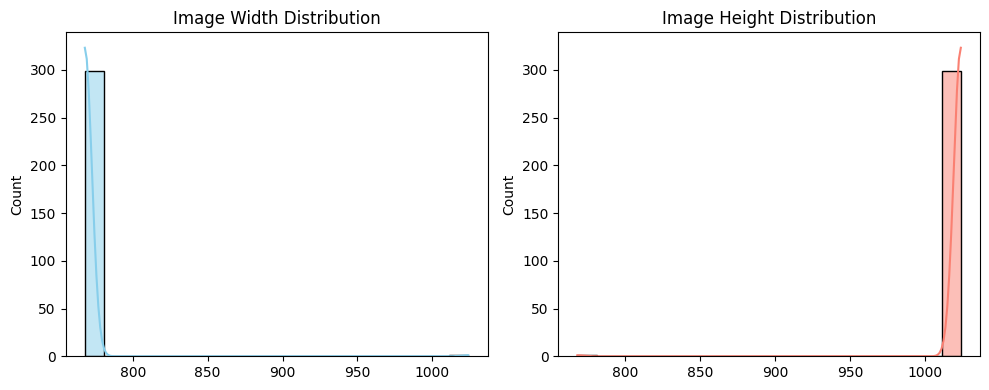

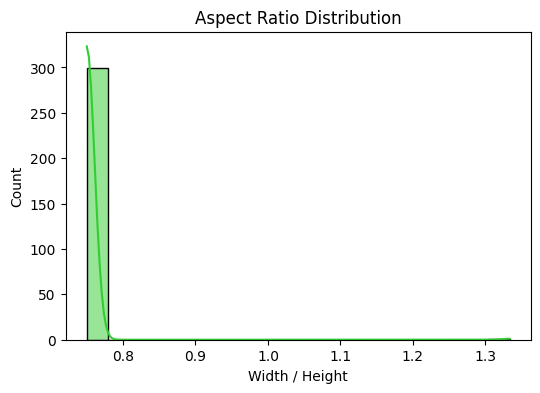

In [12]:
image_paths = glob('/content/drive/MyDrive/archive/aquarium_pretrain/train/images/*.jpg')
widths, heights = [], []

for img_path in tqdm(image_paths[:300]):
    img = cv2.imread(img_path)
    h, w, _ = img.shape
    widths.append(w)
    heights.append(h)

plt.figure(figsize=(10,4))

plt.subplot(1,2,1)
sns.histplot(widths, kde=True, bins=20, color='skyblue')
plt.title("Image Width Distribution")

plt.subplot(1,2,2)
sns.histplot(heights, kde=True, bins=20, color='salmon')
plt.title("Image Height Distribution")

plt.tight_layout()
plt.show()

# Aspect Ratio
aspect_ratios = np.array(widths) / np.array(heights)
plt.figure(figsize=(6,4))
sns.histplot(aspect_ratios, kde=True, bins=20, color='limegreen')
plt.title("Aspect Ratio Distribution")
plt.xlabel("Width / Height")
plt.show()


In [13]:
#Augmentation for the training phase

transform = A.Compose([
    A.RandomBrightnessContrast(p=0.2),
    A.HorizontalFlip(p=0.5),
    A.Rotate(limit=15, p=0.4),
    A.Resize(224, 224),
    A.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ToTensorV2()
])


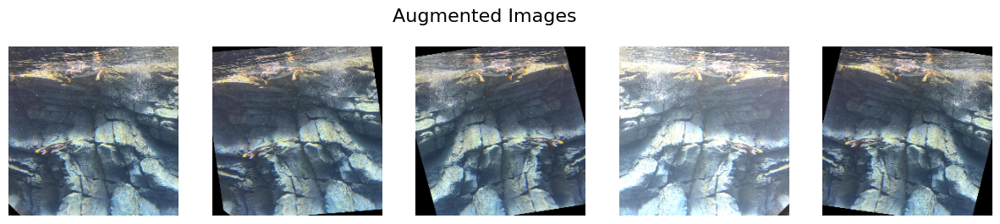

In [14]:
def visualize_augmented(image_path, transform, n=5):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(15, 3))
    for i in range(n):
        aug = transform(image=img)['image']
        img_np = aug.permute(1, 2, 0).numpy()
        img_np = ((img_np * 0.5 + 0.5) * 255).astype(np.uint8)

        plt.subplot(1, n, i+1)
        plt.imshow(img_np)
        plt.axis('off')
    plt.suptitle("Augmented Images", fontsize=16)
    plt.show()

#Testing with a random image
visualize_augmented(image_paths[0], transform)


In [15]:
!pip install ultralytics --quiet
from ultralytics import YOLO
import torch


In [27]:
#Yolov8 Model for object detection - you only look once
model = YOLO('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 231MB/s]


In [28]:
results = model.train(
    data="/content/drive/MyDrive/archive/aquarium_pretrain/data.yaml",
    epochs=20,
    imgsz=640,
    batch=8,
    project="AquariumYOLO",
    name="yolov8n-custom",
    exist_ok=True
)


Ultralytics 8.3.104 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/archive/aquarium_pretrain/data.yaml, epochs=20, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=AquariumYOLO, name=yolov8n-custom, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fal

train: Scanning /content/drive/MyDrive/archive/aquarium_pretrain/train/labels.cache... 448 images, 1 backgrounds, 0 corrupt: 100%|██████████| 448/448 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/archive/aquarium_pretrain/valid/labels.cache... 127 images, 0 backgrounds, 0 corrupt: 100%|██████████| 127/127 [00:00<?, ?it/s]


Plotting labels to AquariumYOLO/yolov8n-custom/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000909, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to AquariumYOLO/yolov8n-custom
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.33G      1.516      3.034      1.311         63        640: 100%|██████████| 56/56 [00:14<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.37it/s]

                   all        127        909      0.343      0.433      0.361      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.89G       1.46      1.857      1.261         78        640: 100%|██████████| 56/56 [00:12<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.12it/s]

                   all        127        909      0.452      0.532      0.467      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.89G       1.48      1.704      1.277         72        640: 100%|██████████| 56/56 [00:12<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.73it/s]


                   all        127        909      0.472      0.512      0.469      0.265

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.89G      1.453      1.628      1.273        108        640: 100%|██████████| 56/56 [00:12<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.99it/s]


                   all        127        909      0.507      0.502      0.526      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.89G      1.467      1.466      1.269         88        640: 100%|██████████| 56/56 [00:12<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]


                   all        127        909      0.562      0.585      0.566      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20       2.9G      1.437      1.418      1.245        118        640: 100%|██████████| 56/56 [00:12<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.84it/s]

                   all        127        909      0.717      0.523      0.625      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.94G      1.419      1.387      1.233        129        640: 100%|██████████| 56/56 [00:12<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.19it/s]

                   all        127        909      0.666      0.597      0.631      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.97G       1.43      1.255      1.218         64        640: 100%|██████████| 56/56 [00:12<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.89it/s]


                   all        127        909      0.673      0.626      0.664      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.99G      1.357      1.199      1.203         41        640: 100%|██████████| 56/56 [00:13<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        127        909       0.64      0.653      0.684      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.99G      1.345      1.146      1.192        160        640: 100%|██████████| 56/56 [00:11<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.17it/s]

                   all        127        909      0.737      0.629      0.689      0.393


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.99G      1.302      1.177      1.179         39        640: 100%|██████████| 56/56 [00:12<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.98it/s]

                   all        127        909       0.67      0.652      0.679      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.99G      1.271      1.108       1.17         31        640: 100%|██████████| 56/56 [00:11<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]

                   all        127        909      0.744      0.625      0.675      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.99G      1.279       1.06      1.141         47        640: 100%|██████████| 56/56 [00:12<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.19it/s]


                   all        127        909       0.75      0.628      0.684      0.397

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.99G      1.248     0.9696      1.137         31        640: 100%|██████████| 56/56 [00:12<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]

                   all        127        909      0.781      0.691       0.75      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.99G      1.216     0.9158      1.118         57        640: 100%|██████████| 56/56 [00:12<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.45it/s]

                   all        127        909       0.75      0.709      0.746      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.99G      1.192      0.879      1.103         34        640: 100%|██████████| 56/56 [00:12<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]


                   all        127        909      0.758      0.722      0.749      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.99G      1.173     0.8124      1.099         54        640: 100%|██████████| 56/56 [00:13<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]

                   all        127        909      0.787      0.703       0.75      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.99G      1.149     0.7995      1.077         46        640: 100%|██████████| 56/56 [00:12<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        127        909      0.771      0.701      0.744      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.99G      1.135     0.7709      1.079         41        640: 100%|██████████| 56/56 [00:12<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]

                   all        127        909       0.77      0.698      0.756      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.99G      1.122     0.7468      1.064         63        640: 100%|██████████| 56/56 [00:12<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.09it/s]

                   all        127        909      0.798      0.693       0.76      0.474



20 epochs completed in 0.086 hours.
Optimizer stripped from AquariumYOLO/yolov8n-custom/weights/last.pt, 22.5MB
Optimizer stripped from AquariumYOLO/yolov8n-custom/weights/best.pt, 22.5MB

Validating AquariumYOLO/yolov8n-custom/weights/best.pt...
Ultralytics 8.3.104 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,128,293 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.02it/s]


                   all        127        909        0.8      0.691       0.76      0.474
                  fish         63        459      0.832      0.736      0.828      0.488
             jellyfish          9        155      0.824      0.877      0.909      0.526
               penguin         17        104       0.71      0.684      0.755       0.35
                puffin         15         74      0.707        0.5      0.587       0.32
                 shark         28         57      0.806      0.596      0.665      0.455
              starfish         17         27      0.941      0.704      0.804      0.619
              stingray         23         33      0.777      0.741      0.768      0.562
Speed: 0.3ms preprocess, 5.9ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to AquariumYOLO/yolov8n-custom


In [29]:
model = YOLO("AquariumYOLO/yolov8n-custom/weights/best.pt")


In [30]:
#Test Predictions
test_images_path = '/content/drive/MyDrive/archive/aquarium_pretrain/test/images/*.jpg'
model.predict(
    source=test_images_path,
    conf=0.25,
    save=True,
    save_txt=True,
    project="AquariumYOLO",
    name="yolov8n-preds"
)



image 1/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg: 640x480 1 penguin, 34.8ms
image 2/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg: 640x480 23 penguins, 12.1ms
image 3/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg: 640x480 10 penguins, 11.8ms
image 4/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg: 640x480 3 penguins, 11.8ms
image 5/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg: 640x480 5 penguins, 11.8ms
image 6/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg: 640x480 3 fishs, 11.8ms
image 7/63 /content/drive/MyDrive/archive/aquarium_pr

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'fish', 1: 'jellyfish', 2: 'penguin', 3: 'puffin', 4: 'shark', 5: 'starfish', 6: 'stingray'}
 obb: None
 orig_img: array([[[235, 233, 193],
         [234, 232, 192],
         [231, 228, 190],
         ...,
         [129, 124, 121],
         [128, 123, 122],
         [128, 123, 122]],
 
        [[232, 225, 186],
         [226, 221, 182],
         [221, 215, 178],
         ...,
         [131, 126, 123],
         [130, 125, 124],
         [130, 125, 124]],
 
        [[235, 221, 185],
         [225, 213, 177],
         [213, 201, 167],
         ...,
         [128, 123, 120],
         [128, 123, 120],
         [128, 123, 120]],
 
        ...,
 
        [[  1,   2,   0],
         [  1,   2,   0],
         [  1,   2,   0],
         ...,
         [ 35,  22,   8],
         [ 35,  22,   8],
         [ 35,  22,   8]],
 
        [[  1,   2,   0],
 

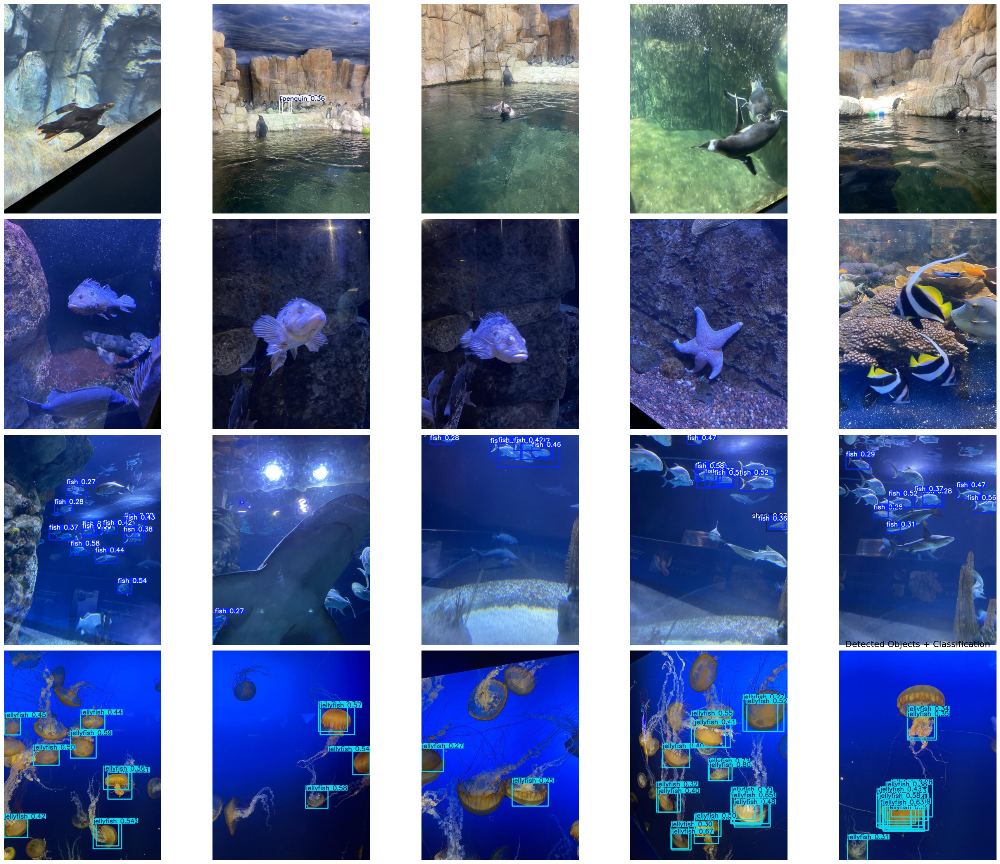

In [31]:
from PIL import Image
import glob

def show_prediction_grid(pred_dir, num_images=20, grid_size=(4,5), image_size=(224,224)):
    pred_images = sorted(glob.glob(os.path.join(pred_dir, "*.jpg")))[:num_images]

    fig, axs = plt.subplots(*grid_size, figsize=(image_size[0]/40 * grid_size[1], image_size[1]/40 * grid_size[0]))
    axs = axs.flatten()

    for i, img_path in enumerate(pred_images):
        img = Image.open(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.tight_layout()
    plt.title("Detected Objects + Classification", fontsize=16)
    plt.show()

#Prediction
show_prediction_grid("AquariumYOLO/yolov8n-preds", num_images=20, grid_size=(4, 5), image_size=(224, 224))


In [23]:
!find /content -name "best.pt"


/content/AquariumYOLO/yolov8n-custom/weights/best.pt


In [39]:
from pathlib import Path
import numpy as np

source_path = Path("/content/AquariumYOLO/yolov8n-preds")
image_paths = list(source_path.glob("*.jpg"))

custom_plurals = {
    'fish': 'fish',
    'jellyfish': 'jellyfish',
    'penguin': 'penguins',
    'puffin': 'puffins',
    'shark': 'sharks',
    'starfish': 'starfish',
    'stingray': 'stingrays'
}

for img_path in image_paths:
    result = model.predict(source=str(img_path))[0]
    print(f"\n {img_path.name}:")
    unique_classes, counts = np.unique(result.boxes.cls.cpu().numpy(), return_counts=True)
    for cls, count in zip(unique_classes, counts):
        label = model.names[int(cls)]
        plural_label = custom_plurals.get(label, label + 's')
        print(f"   {count} {plural_label}")



image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_3175_jpeg_jpg.rf.686c7d36e049eea974a363e99bf0bee0.jpg: 480x640 10 penguins, 14.7ms
Speed: 3.7ms preprocess, 14.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)

 IMG_3175_jpeg_jpg.rf.686c7d36e049eea974a363e99bf0bee0.jpg:
   10 penguins

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_2379_jpeg_jpg.rf.7dc3160c937072d26d4624c6c48e904d.jpg: 640x480 2 fishs, 1 starfish, 13.2ms
Speed: 2.4ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)

 IMG_2379_jpeg_jpg.rf.7dc3160c937072d26d4624c6c48e904d.jpg:
   2 fish
   1 starfish

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_8452_jpg.rf.6bbff701ab93e29553b3a70137fd4e66.jpg: 480x640 64 fishs, 13.8ms
Speed: 2.3ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

 IMG_8452_jpg.rf.6bbff701ab93e29553b3a70137fd4e66.jpg:
   64 fish

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_8490_jpg.rf.1836542cf054c6d3

In [40]:
import cv2
import os
from ultralytics import YOLO
from PIL import Image

# Load trained YOLO model
model = YOLO('/content/AquariumYOLO/yolov8n-custom/weights/best.pt')

# Directory setup
detected_images_dir = 'AquariumYOLO/yolov8n-preds/crops'
os.makedirs(detected_images_dir, exist_ok=True)

# Paths for cropped data
cropped_train_dir = os.path.join(detected_images_dir, "train")
os.makedirs(cropped_train_dir, exist_ok=True)

# Crop function
def crop_objects_from_predictions(images_path, save_path):
    images = [f for f in os.listdir(images_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

    for img_name in images:
        img_path = os.path.join(images_path, img_name)
        results = model(img_path)[0]

        img = cv2.imread(img_path)
        boxes = results.boxes
        names = results.names

        for i, box in enumerate(boxes):
            class_id = int(box.cls[0])
            class_name = names[class_id]
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())

            crop = img[y1:y2, x1:x2]
            class_dir = os.path.join(save_path, class_name)
            os.makedirs(class_dir, exist_ok=True)

            save_crop_path = os.path.join(class_dir, f"{img_name.split('.')[0]}_{i}.jpg")
            cv2.imwrite(save_crop_path, crop)

crop_objects_from_predictions('AquariumYOLO/yolov8n-preds', cropped_train_dir)
print("Cropped object images saved successfully.")



image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_3175_jpeg_jpg.rf.686c7d36e049eea974a363e99bf0bee0.jpg: 480x640 10 penguins, 27.0ms
Speed: 3.8ms preprocess, 27.0ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_2379_jpeg_jpg.rf.7dc3160c937072d26d4624c6c48e904d.jpg: 640x480 2 fishs, 1 starfish, 13.5ms
Speed: 3.8ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_8452_jpg.rf.6bbff701ab93e29553b3a70137fd4e66.jpg: 480x640 64 fishs, 14.3ms
Speed: 3.5ms preprocess, 14.3ms inference, 2.5ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_8490_jpg.rf.1836542cf054c6d303a2dd05d4194d7f.jpg: 480x640 58 jellyfishs, 13.3ms
Speed: 3.8ms preprocess, 13.3ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_2380_jpeg_jpg.rf.a23809682eb

In [42]:
import os

print(os.getcwd())  #current working directory
print(os.listdir())  #all folders/files in the current directory


/content
['.config', 'cropped_train', 'AquariumYOLO', 'yolo11n.pt', 'yolov8s.pt', 'drive', 'sample_data']


In [45]:
import os
import shutil
from sklearn.model_selection import train_test_split

source_dir = 'cropped_train'
dataset_dir = 'dataset'
class_names = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']

# Create folders
for split in ['train', 'val']:
    for cls in class_names:
        os.makedirs(os.path.join(dataset_dir, split, cls), exist_ok=True)

# Sort files by class and split
all_files = os.listdir(source_dir)
for cls in class_names:
    cls_files = [f for f in all_files if f.startswith(cls)]

    if len(cls_files) == 0:
        print(f"Skipping class '{cls}' – no images found.")
        continue

    train_files, val_files = train_test_split(cls_files, test_size=0.2, random_state=42)

    for f in train_files:
        shutil.copy(os.path.join(source_dir, f), os.path.join(dataset_dir, 'train', cls, f))
    for f in val_files:
        shutil.copy(os.path.join(source_dir, f), os.path.join(dataset_dir, 'val', cls, f))

print("Dataset organized and split successfully.")


Skipping class 'fish' – no images found.
Skipping class 'jellyfish' – no images found.
Skipping class 'penguin' – no images found.
Skipping class 'puffin' – no images found.
Skipping class 'shark' – no images found.
Skipping class 'starfish' – no images found.
Skipping class 'stingray' – no images found.
Dataset organized and split successfully.


In [46]:
import os

source_dir = 'cropped_train'
files = os.listdir(source_dir)
print(f"Total files in cropped_train: {len(files)}")
print("Sample file names:", files[:10])


Total files in cropped_train: 0
Sample file names: []


In [55]:
import cv2
import os
from ultralytics import YOLO

model = YOLO("yolov8s.pt")

source_folder = "/content/AquariumYOLO/yolov8n-preds/crops"
dest_dir = "cropped_train"
os.makedirs(dest_dir, exist_ok=True)

for img_file in os.listdir(source_folder):
    if img_file.endswith(".jpg") or img_file.endswith(".png"):
        img_path = os.path.join(source_folder, img_file)
        img = cv2.imread(img_path)
        results = model.predict(source=img_path, save=False, verbose=False)

        for result in results:
            for i, box in enumerate(result.boxes):
                cls_id = int(box.cls)
                class_name = model.names[cls_id]

                # Bounding box
                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cropped_img = img[y1:y2, x1:x2]

                # Save with a prefix of class name
                filename = f"{class_name}_{img_file.split('.')[0]}_{i}.jpg"
                save_path = os.path.join(dest_dir, filename)
                cv2.imwrite(save_path, cropped_img)


In [56]:
print("Total cropped:", len(os.listdir("cropped_train")))
print("Sample:", os.listdir("cropped_train")[:5])


Total cropped: 0
Sample: []


In [60]:
from ultralytics import YOLO
from PIL import Image

model = YOLO('/content/AquariumYOLO/yolov8n-custom/weights/best.pt')

img_path = '/content/AquariumYOLO/yolov8n-preds/IMG_3175_jpeg_jpg.rf.686c7d36e049eea974a363e99bf0bee0.jpg'

results = model.predict(source=img_path, show=True, conf=0.25)

for r in results:
    print(r.boxes)


WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


image 1/1 /content/AquariumYOLO/yolov8n-preds/IMG_3175_jpeg_jpg.rf.686c7d36e049eea974a363e99bf0bee0.jpg: 480x640 10 penguins, 14.0ms
Speed: 3.4ms preprocess, 14.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([2., 2., 2., 2., 2., 2., 2., 2., 2., 2.], device='cuda:0')
conf: tensor([0.9358, 0.7835, 0.5148, 0.4980, 0.4962, 0.4651, 0.4147, 0.4108, 0.3519, 0.3202], device='cuda:0')
data: tensor([[2.9626e+02, 3.2692e+02, 9.0971e+02, 5.9105e+02, 9.3576e-01, 2.0000e+00],
        [8.7140e+02, 1.9359e+02, 9.1521e+02, 2.6687e+02, 7.8349e-01, 2.0000e+00],
        [2.6186e+01, 2.4364e+02, 8.1018e+01, 3.1081e+02, 5.1483e-01, 2.0000e+00],
        [4.1265e+02, 1.9264e+02, 4.3496e+02, 2.3058e+02, 4.9800e-01, 2.0000e+00],
        [8.3571e+02, 2.4205e+02, 8.6185e+02, 2.7244e+02, 4.9620e-01, 2.0000e+00],
        [9.2981e+02, 2.0574e+02, 9.743

In [65]:
pip install ultralytics torchvision torchcam opencv-python


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 92.8 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2


In [69]:
from ultralytics import YOLO
import cv2
from PIL import Image
import torch
import torchvision.transforms as T

yolo_model = YOLO("yolov8s.pt")

image_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg"
results = yolo_model(image_path)[0]
img_cv = cv2.imread(image_path)
img_pil = Image.open(image_path).convert("RGB")

class_ids = results.boxes.cls.tolist()
confidences = results.boxes.conf.tolist()
bboxes = results.boxes.xyxy.tolist()



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg: 640x384 1 person, 1 elephant, 22.4ms
Speed: 2.4ms preprocess, 22.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)


In [70]:
image_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg"
results = yolo_model(image_path)[0]



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg: 640x384 1 person, 1 elephant, 14.7ms
Speed: 2.4ms preprocess, 14.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


In [71]:
crops = []
boxes = results.boxes.xyxy.cpu().numpy()  # Get bounding boxes
for box in boxes:
    x1, y1, x2, y2 = map(int, box)
    crop = img_pil.crop((x1, y1, x2, y2))
    crops.append((crop, (x1, y1, x2, y2)))


In [72]:
from torchvision.models import resnet18
from torchcam.methods import SmoothGradCAMpp
import matplotlib.pyplot as plt
import numpy as np

# Load classifier
classifier = resnet18(pretrained=True)
classifier.eval()

# Attach CAM extractor
cam_extractor = SmoothGradCAMpp(classifier)

# Transform for classifier
transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225])
])

# For each crop: classify, explain, and overlay
for i, (crop, (x1, y1, x2, y2)) in enumerate(crops):
    input_tensor = transform(crop).unsqueeze(0)
    out = classifier(input_tensor)
    class_id = out.argmax().item()

    # Get CAM heatmap
    activation_map = cam_extractor(class_id, out)[0].squeeze().detach().numpy()
    heatmap = cv2.resize(activation_map, (crop.width, crop.height))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Overlay on the crop
    crop_np = np.array(crop)
    overlayed = cv2.addWeighted(crop_np, 0.5, heatmap, 0.5, 0)

    # Replace in the original image
    img_cv[y1:y2, x1:x2] = overlayed


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 108MB/s]


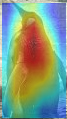

True

In [74]:
from google.colab.patches import cv2_imshow
import cv2

cv2_imshow(img_cv)

cv2.imwrite("explained_output.jpg", img_cv)




image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_12.jpg: 640x640 (no detections), 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_12.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2354_jpeg_jpg_4.jpg: 480x640 (no detections), 15.4ms
Speed: 2.8ms preprocess, 15.4ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: pred_IMG_2354_jpeg_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_8.jpg: 640x384 (no detections), 12.2ms
Speed: 3.0ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_2319_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_13.jpg: 640x384 (no detections), 11.6ms
Speed: 1.9ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3164_jpeg_jpg_13.jpg


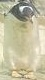


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_18.jpg: 640x640 1 tv, 17.5ms
Speed: 3.0ms preprocess, 17.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_18.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_8.jpg: 640x480 3 tvs, 13.8ms
Speed: 2.3ms preprocess, 13.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_3164_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_11.jpg: 640x384 (no detections), 14.9ms
Speed: 2.0ms preprocess, 14.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2301_jpeg_jpg_11.jpg


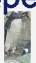


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2347_jpeg_jpg_0.jpg: 576x640 1 cow, 18.9ms
Speed: 3.3ms preprocess, 18.9ms inference, 3.3ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2347_jpeg_jpg_0.jpg


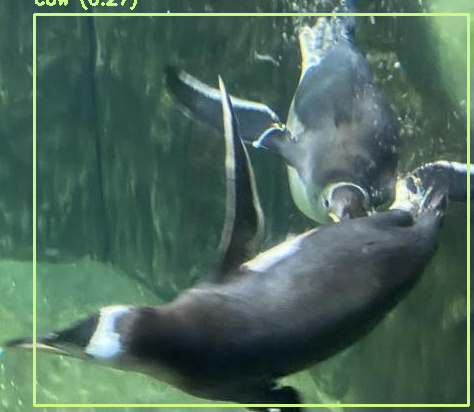


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_9.jpg: 640x416 (no detections), 21.0ms
Speed: 2.3ms preprocess, 21.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_3175_jpeg_jpg_9.jpg


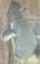


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_1.jpg: 640x480 (no detections), 17.1ms
Speed: 2.3ms preprocess, 17.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_3173_jpeg_jpg_1.jpg


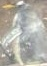


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_4.jpg: 640x576 (no detections), 18.8ms
Speed: 2.8ms preprocess, 18.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: pred_IMG_3175_jpeg_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2347_jpeg_jpg_0.jpg: 576x640 1 cow, 15.2ms
Speed: 5.2ms preprocess, 15.2ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: pred_IMG_2347_jpeg_jpg_0.jpg


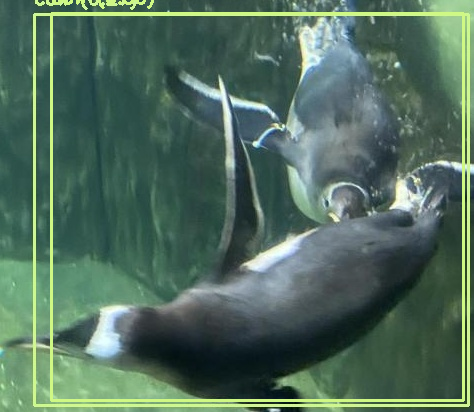


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_2.jpg: 640x448 (no detections), 12.0ms
Speed: 2.4ms preprocess, 12.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3173_jpeg_jpg_2.jpg


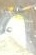


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_6.jpg: 640x448 1 tv, 10.7ms
Speed: 1.9ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_3164_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_10.jpg: 640x384 (no detections), 11.2ms
Speed: 2.0ms preprocess, 11.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_3164_jpeg_jpg_10.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_5.jpg: 640x576 (no detections), 15.3ms
Speed: 3.2ms preprocess, 15.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: pred_IMG_3175_jpeg_jpg_5.jpg


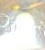


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2354_jpeg_jpg_4.jpg: 480x640 (no detections), 12.8ms
Speed: 2.5ms preprocess, 12.8ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2354_jpeg_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2289_jpeg_jpg_0.jpg: 416x640 1 bird, 12.2ms
Speed: 2.4ms preprocess, 12.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: pred_IMG_2289_jpeg_jpg_0.jpg


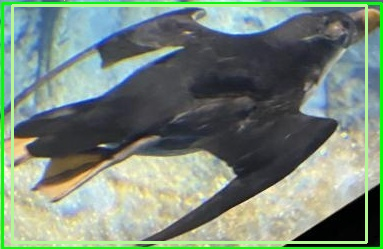


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_3.jpg: 640x352 (no detections), 10.8ms
Speed: 1.6ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: pred_IMG_2301_jpeg_jpg_3.jpg


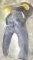


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_6.jpg: 640x480 (no detections), 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_2319_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_2.jpg: 640x512 (no detections), 12.2ms
Speed: 2.6ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_2319_jpeg_jpg_2.jpg


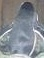


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_3.jpg: 640x480 (no detections), 11.8ms
Speed: 2.2ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_3164_jpeg_jpg_3.jpg


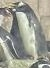


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3134_jpeg_jpg_2.jpg: 640x608 (no detections), 18.2ms
Speed: 3.0ms preprocess, 18.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_3134_jpeg_jpg_2.jpg


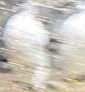


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_7.jpg: 640x352 (no detections), 10.3ms
Speed: 3.8ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: pred_IMG_3173_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_6.jpg: 640x544 (no detections), 15.1ms
Speed: 2.6ms preprocess, 15.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3175_jpeg_jpg_6.jpg


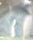


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3134_jpeg_jpg_1.jpg: 256x640 (no detections), 10.9ms
Speed: 1.5ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: pred_IMG_3134_jpeg_jpg_1.jpg


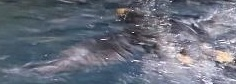


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2347_jpeg_jpg_1.jpg: 384x640 1 bird, 1 dog, 11.0ms
Speed: 2.5ms preprocess, 11.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2347_jpeg_jpg_1.jpg


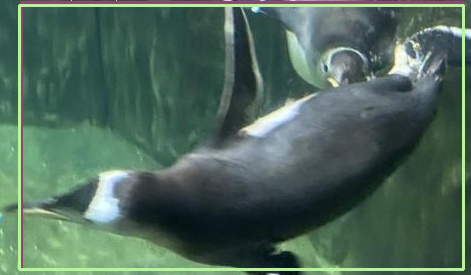


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_1.jpg: 480x640 1 person, 1 elephant, 11.5ms
Speed: 2.4ms preprocess, 11.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2319_jpeg_jpg_1.jpg


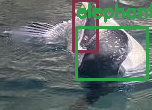


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_1.jpg: 640x576 (no detections), 13.6ms
Speed: 2.9ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: pred_IMG_2301_jpeg_jpg_1.jpg


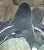


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_7.jpg: 640x480 (no detections), 10.7ms
Speed: 2.5ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2301_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_4.jpg: 608x640 (no detections), 13.8ms
Speed: 3.1ms preprocess, 13.8ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: pred_IMG_3173_jpeg_jpg_4.jpg


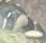


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_10.jpg: 576x640 (no detections), 13.6ms
Speed: 2.9ms preprocess, 13.6ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: pred_IMG_2319_jpeg_jpg_10.jpg


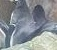


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2347_jpeg_jpg_1.jpg: 384x640 1 dog, 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: pred_IMG_2347_jpeg_jpg_1.jpg


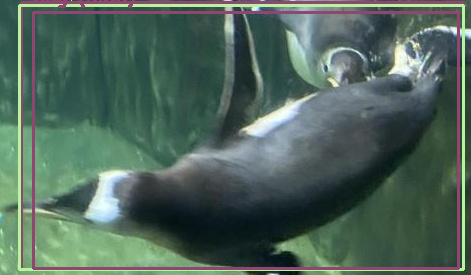


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_10.jpg: 640x640 (no detections), 14.1ms
Speed: 3.2ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_10.jpg


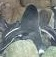


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_14.jpg: 640x448 (no detections), 11.9ms
Speed: 2.5ms preprocess, 11.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3164_jpeg_jpg_14.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_7.jpg: 640x480 1 tv, 11.0ms
Speed: 2.4ms preprocess, 11.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_2301_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_12.jpg: 640x480 (no detections), 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_3164_jpeg_jpg_12.jpg


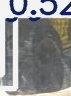


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2347_jpeg_jpg_2.jpg: 640x544 (no detections), 13.7ms
Speed: 3.2ms preprocess, 13.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: pred_IMG_2347_jpeg_jpg_2.jpg


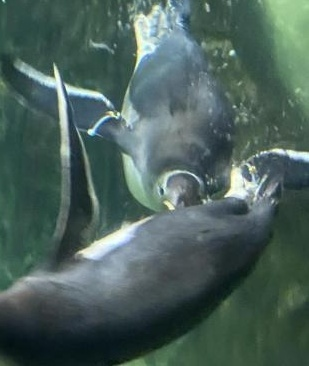


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_2.jpg: 448x640 (no detections), 11.3ms
Speed: 2.5ms preprocess, 11.3ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_3164_jpeg_jpg_2.jpg


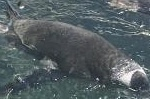


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_3.jpg: 224x640 1 surfboard, 10.9ms
Speed: 1.5ms preprocess, 10.9ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_3173_jpeg_jpg_3.jpg


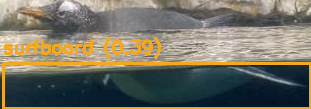


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_7.jpg: 640x512 (no detections), 10.8ms
Speed: 2.5ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_2319_jpeg_jpg_7.jpg


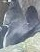


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_5.jpg: 640x640 (no detections), 14.2ms
Speed: 3.6ms preprocess, 14.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_3173_jpeg_jpg_5.jpg


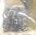


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_13.jpg: 640x384 (no detections), 9.6ms
Speed: 2.9ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_3164_jpeg_jpg_13.jpg


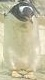


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_14.jpg: 640x448 (no detections), 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_3164_jpeg_jpg_14.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_7.jpg: 640x512 (no detections), 10.7ms
Speed: 2.5ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_2319_jpeg_jpg_7.jpg


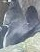


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_10.jpg: 640x640 (no detections), 14.1ms
Speed: 4.0ms preprocess, 14.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_10.jpg


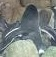


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_9.jpg: 640x320 (no detections), 10.0ms
Speed: 1.7ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: pred_IMG_2319_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_9.jpg: 640x544 (no detections), 13.6ms
Speed: 5.4ms preprocess, 13.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: pred_IMG_2301_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_3.jpg: 640x384 (no detections), 11.8ms
Speed: 1.8ms preprocess, 11.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3175_jpeg_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_0.jpg: 640x384 (no detections), 11.0ms
Speed: 1.7ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_3173_jpeg_jpg_0.jpg


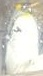


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_0.jpg: 640x448 1 person, 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_2319_jpeg_jpg_0.jpg


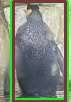


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_9.jpg: 640x512 1 tv, 9.9ms
Speed: 2.4ms preprocess, 9.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_3164_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_9.jpg: 640x512 (no detections), 8.9ms
Speed: 2.3ms preprocess, 8.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_3164_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_7.jpg: 640x640 (no detections), 12.7ms
Speed: 2.9ms preprocess, 12.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_3175_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_5.jpg: 640x416 (no detections), 9.4ms
Speed: 2.3ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_3164_jpeg_jpg_5.jpg


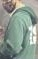


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_12.jpg: 640x480 (no detections), 9.7ms
Speed: 2.3ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_3164_jpeg_jpg_12.jpg


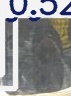


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_4.jpg: 640x576 (no detections), 12.5ms
Speed: 2.6ms preprocess, 12.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_3175_jpeg_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_6.jpg: 640x320 (no detections), 9.3ms
Speed: 1.5ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: pred_IMG_2301_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_6.jpg: 640x480 (no detections), 9.8ms
Speed: 2.1ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2319_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_2.jpg: 640x352 (no detections), 11.5ms
Speed: 1.8ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_2301_jpeg_jpg_2.jpg


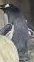


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_2.jpg: 640x352 (no detections), 8.3ms
Speed: 1.6ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: pred_IMG_2301_jpeg_jpg_2.jpg


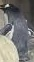


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_2.jpg: 640x512 (no detections), 8.9ms
Speed: 2.5ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_2319_jpeg_jpg_2.jpg


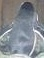


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_13.jpg: 640x512 (no detections), 8.7ms
Speed: 2.4ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_2301_jpeg_jpg_13.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_8.jpg: 640x480 (no detections), 12.5ms
Speed: 2.1ms preprocess, 12.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_3164_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3134_jpeg_jpg_1.jpg: 256x640 (no detections), 9.9ms
Speed: 1.6ms preprocess, 9.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_3134_jpeg_jpg_1.jpg


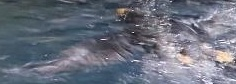


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_14.jpg: 320x640 (no detections), 9.7ms
Speed: 1.7ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2301_jpeg_jpg_14.jpg


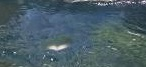


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_6.jpg: 640x544 (no detections), 10.7ms
Speed: 2.4ms preprocess, 10.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: pred_IMG_3175_jpeg_jpg_6.jpg


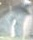


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2354_jpeg_jpg_2.jpg: 640x608 (no detections), 11.0ms
Speed: 2.9ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: pred_IMG_2354_jpeg_jpg_2.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_8.jpg: 640x384 (no detections), 10.0ms
Speed: 1.9ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2319_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_5.jpg: 640x352 (no detections), 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: pred_IMG_2319_jpeg_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_9.jpg: 640x320 (no detections), 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_2319_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_7.jpg: 640x640 (no detections), 10.9ms
Speed: 2.8ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_3175_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_0.jpg: 288x640 (no detections), 9.0ms
Speed: 1.9ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: pred_IMG_3175_jpeg_jpg_0.jpg


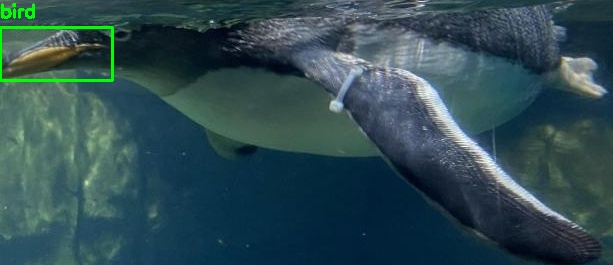


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_8.jpg: 640x416 (no detections), 10.2ms
Speed: 2.0ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2301_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_3.jpg: 640x352 (no detections), 8.4ms
Speed: 1.6ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_2301_jpeg_jpg_3.jpg


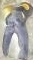


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_0.jpg: 640x384 1 person, 9.5ms
Speed: 1.9ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_2301_jpeg_jpg_0.jpg


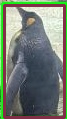


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_5.jpg: 640x640 (no detections), 11.1ms
Speed: 3.2ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_9.jpg: 640x544 (no detections), 10.7ms
Speed: 2.8ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_2301_jpeg_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_8.jpg: 640x416 (no detections), 9.8ms
Speed: 2.0ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: pred_IMG_2301_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_7.jpg: 160x640 (no detections), 10.7ms
Speed: 1.1ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)
Predictions for: IMG_3164_jpeg_jpg_7.jpg


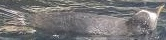


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_16.jpg: 640x640 (no detections), 11.0ms
Speed: 2.8ms preprocess, 11.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_16.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_0.jpg: 640x384 (no detections), 9.8ms
Speed: 2.1ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3173_jpeg_jpg_0.jpg


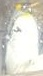


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_6.jpg: 640x320 (no detections), 8.6ms
Speed: 1.5ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_2301_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_2.jpg: 640x544 (no detections), 10.7ms
Speed: 2.4ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3175_jpeg_jpg_2.jpg


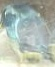


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_4.jpg: 192x640 (no detections), 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 640)
Predictions for: IMG_3164_jpeg_jpg_4.jpg


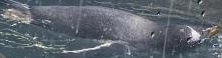


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_12.jpg: 640x640 (no detections), 11.4ms
Speed: 2.8ms preprocess, 11.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_12.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_3.jpg: 640x384 (no detections), 9.3ms
Speed: 1.8ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_3175_jpeg_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_4.jpg: 640x352 (no detections), 11.5ms
Speed: 1.9ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_2301_jpeg_jpg_4.jpg


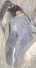


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_3.jpg: 640x480 (no detections), 9.5ms
Speed: 2.3ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_3164_jpeg_jpg_3.jpg


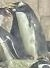


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2354_jpeg_jpg_3.jpg: 416x640 2 cars, 9.2ms
Speed: 2.0ms preprocess, 9.2ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2354_jpeg_jpg_3.jpg


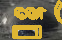


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_1.jpg: 640x416 (no detections), 11.2ms
Speed: 2.0ms preprocess, 11.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: pred_IMG_3175_jpeg_jpg_1.jpg


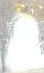


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_10.jpg: 640x384 (no detections), 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3164_jpeg_jpg_10.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_1.jpg: 320x640 1 dog, 1 bear, 9.7ms
Speed: 1.9ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: pred_IMG_3164_jpeg_jpg_1.jpg


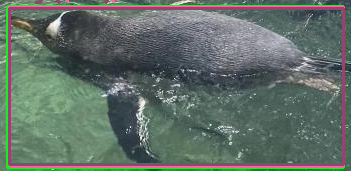


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_6.jpg: 640x416 (no detections), 9.8ms
Speed: 2.4ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: pred_IMG_3173_jpeg_jpg_6.jpg


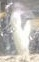


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_11.jpg: 640x384 (no detections), 9.9ms
Speed: 1.9ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: pred_IMG_2301_jpeg_jpg_11.jpg


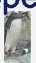


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_5.jpg: 640x640 (no detections), 11.1ms
Speed: 3.1ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_4.jpg: 640x448 (no detections), 10.0ms
Speed: 2.4ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_2319_jpeg_jpg_4.jpg


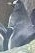


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_0.jpg: 640x448 1 person, 9.2ms
Speed: 2.1ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_2319_jpeg_jpg_0.jpg


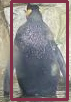


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_3.jpg: 640x608 (no detections), 10.9ms
Speed: 2.4ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2319_jpeg_jpg_3.jpg


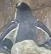


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_1.jpg: 480x640 1 dog, 10.0ms
Speed: 2.5ms preprocess, 10.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: pred_IMG_2319_jpeg_jpg_1.jpg


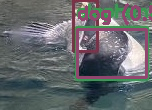


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2354_jpeg_jpg_1.jpg: 640x512 (no detections), 10.7ms
Speed: 2.5ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_2354_jpeg_jpg_1.jpg


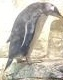


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_18.jpg: 640x640 1 tv, 11.0ms
Speed: 3.0ms preprocess, 11.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_18.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg: 640x384 1 person, 1 elephant, 10.1ms
Speed: 1.9ms preprocess, 10.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2301_jpeg_jpg_0.jpg


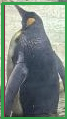


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_15.jpg: 640x480 (no detections), 9.7ms
Speed: 2.3ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: pred_IMG_2301_jpeg_jpg_15.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_14.jpg: 320x640 (no detections), 10.8ms
Speed: 1.9ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_14.jpg


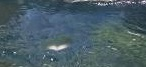


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_0.jpg: 640x576 (no detections), 11.1ms
Speed: 3.1ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: pred_IMG_3164_jpeg_jpg_0.jpg


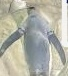


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_1.jpg: 640x576 (no detections), 9.9ms
Speed: 2.8ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_2301_jpeg_jpg_1.jpg


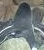


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_17.jpg: 640x640 (no detections), 11.2ms
Speed: 3.1ms preprocess, 11.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_17.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_2.jpg: 640x544 (no detections), 10.8ms
Speed: 5.3ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: pred_IMG_3175_jpeg_jpg_2.jpg


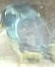


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_5.jpg: 640x352 (no detections), 8.6ms
Speed: 1.5ms preprocess, 8.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_2319_jpeg_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_7.jpg: 160x640 (no detections), 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)
Predictions for: pred_IMG_3164_jpeg_jpg_7.jpg


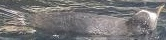


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2354_jpeg_jpg_1.jpg: 640x512 (no detections), 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_2354_jpeg_jpg_1.jpg


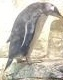


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_16.jpg: 640x640 (no detections), 11.1ms
Speed: 3.2ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2301_jpeg_jpg_16.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_4.jpg: 640x448 (no detections), 9.8ms
Speed: 2.1ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_2319_jpeg_jpg_4.jpg


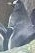


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2319_jpeg_jpg_10.jpg: 576x640 (no detections), 10.5ms
Speed: 2.7ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2319_jpeg_jpg_10.jpg


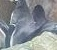


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_0.jpg: 288x640 1 bird, 11.3ms
Speed: 2.2ms preprocess, 11.3ms inference, 1.4ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_3175_jpeg_jpg_0.jpg


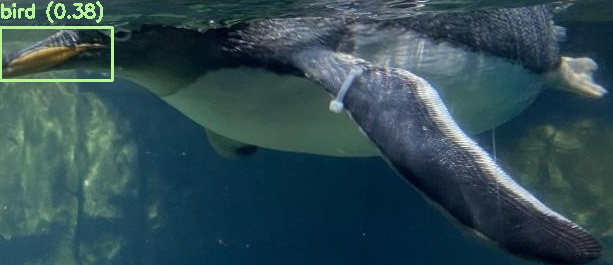


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_4.jpg: 608x640 (no detections), 11.0ms
Speed: 3.0ms preprocess, 11.0ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_3173_jpeg_jpg_4.jpg


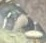


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2354_jpeg_jpg_3.jpg: 416x640 1 train, 10.4ms
Speed: 2.5ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: pred_IMG_2354_jpeg_jpg_3.jpg


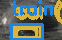


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_11.jpg: 640x512 (no detections), 10.6ms
Speed: 2.9ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: pred_IMG_3164_jpeg_jpg_11.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3134_jpeg_jpg_2.jpg: 640x608 (no detections), 10.8ms
Speed: 3.1ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: pred_IMG_3134_jpeg_jpg_2.jpg


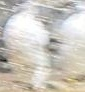


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_2.jpg: 640x448 (no detections), 9.7ms
Speed: 2.3ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_3173_jpeg_jpg_2.jpg


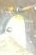


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_13.jpg: 640x512 (no detections), 9.7ms
Speed: 2.2ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_2301_jpeg_jpg_13.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_5.jpg: 640x640 (no detections), 11.0ms
Speed: 3.1ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_3173_jpeg_jpg_5.jpg


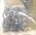


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_15.jpg: 640x480 (no detections), 10.2ms
Speed: 2.4ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2301_jpeg_jpg_15.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_4.jpg: 192x640 (no detections), 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 640)
Predictions for: pred_IMG_3164_jpeg_jpg_4.jpg


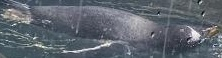


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_3.jpg: 224x640 1 boat, 9.9ms
Speed: 1.4ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: pred_IMG_3173_jpeg_jpg_3.jpg


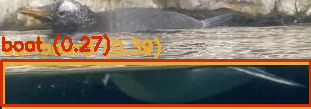


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_17.jpg: 640x640 (no detections), 10.9ms
Speed: 3.0ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_2301_jpeg_jpg_17.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3173_jpeg_jpg_8.jpg: 640x640 (no detections), 10.2ms
Speed: 2.9ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: pred_IMG_3173_jpeg_jpg_8.jpg


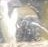


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_8.jpg: 640x640 (no detections), 10.1ms
Speed: 2.8ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_3173_jpeg_jpg_8.jpg


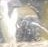


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_9.jpg: 640x416 (no detections), 8.4ms
Speed: 2.1ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: pred_IMG_3175_jpeg_jpg_9.jpg


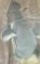


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_0.jpg: 640x576 (no detections), 10.5ms
Speed: 2.7ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_3164_jpeg_jpg_0.jpg


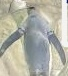


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_7.jpg: 640x352 1 tv, 9.4ms
Speed: 1.8ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_3173_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2354_jpeg_jpg_0.jpg: 640x448 (no detections), 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: pred_IMG_2354_jpeg_jpg_0.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2354_jpeg_jpg_0.jpg: 640x448 (no detections), 8.7ms
Speed: 2.1ms preprocess, 8.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_2354_jpeg_jpg_0.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2354_jpeg_jpg_2.jpg: 640x608 (no detections), 11.0ms
Speed: 3.0ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2354_jpeg_jpg_2.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_6.jpg: 640x448 1 tv, 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3164_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_1.jpg: 640x480 (no detections), 10.0ms
Speed: 2.2ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_3173_jpeg_jpg_1.jpg


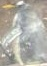


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_5.jpg: 640x416 (no detections), 9.8ms
Speed: 1.9ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: pred_IMG_3164_jpeg_jpg_5.jpg


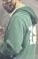


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2289_jpeg_jpg_0.jpg: 416x640 1 bird, 10.6ms
Speed: 2.3ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2289_jpeg_jpg_0.jpg


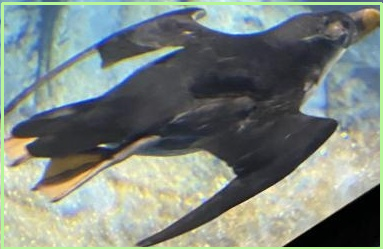


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2301_jpeg_jpg_4.jpg: 640x352 (no detections), 10.4ms
Speed: 2.3ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: pred_IMG_2301_jpeg_jpg_4.jpg


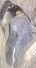


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_5.jpg: 640x576 (no detections), 9.8ms
Speed: 2.9ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_3175_jpeg_jpg_5.jpg


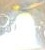


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_1.jpg: 320x640 1 bear, 9.5ms
Speed: 2.1ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_3164_jpeg_jpg_1.jpg


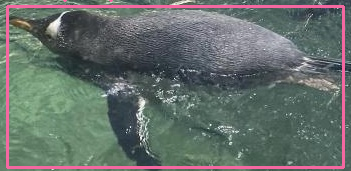


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3164_jpeg_jpg_2.jpg: 448x640 (no detections), 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: pred_IMG_3164_jpeg_jpg_2.jpg


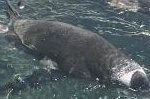


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_1.jpg: 640x416 (no detections), 10.9ms
Speed: 2.1ms preprocess, 10.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_3175_jpeg_jpg_1.jpg


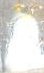


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3175_jpeg_jpg_8.jpg: 640x544 (no detections), 11.6ms
Speed: 2.7ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3175_jpeg_jpg_8.jpg


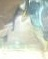


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3164_jpeg_jpg_11.jpg: 640x512 (no detections), 9.8ms
Speed: 2.3ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_3164_jpeg_jpg_11.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_3175_jpeg_jpg_8.jpg: 640x544 (no detections), 10.0ms
Speed: 2.7ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: pred_IMG_3175_jpeg_jpg_8.jpg


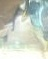


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/pred_IMG_2319_jpeg_jpg_3.jpg: 640x608 (no detections), 9.9ms
Speed: 3.0ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: pred_IMG_2319_jpeg_jpg_3.jpg


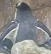


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2347_jpeg_jpg_2.jpg: 640x544 (no detections), 9.9ms
Speed: 2.9ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_2347_jpeg_jpg_2.jpg


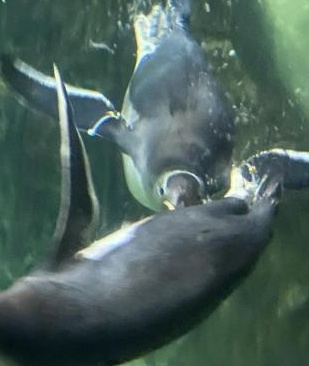


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_3173_jpeg_jpg_6.jpg: 640x416 (no detections), 14.2ms
Speed: 2.5ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_3173_jpeg_jpg_6.jpg


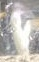

In [77]:
#Adding colours and confidence scores to it -- PENGUIN
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_3.jpg: 384x640 (no detections), 15.9ms
Speed: 2.2ms preprocess, 15.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8497_MOV-0_jpg_3.jpg


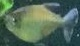


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_3.jpg: 640x512 (no detections), 14.2ms
Speed: 2.3ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8513_MOV-0_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_10.jpg: 576x640 (no detections), 17.2ms
Speed: 3.3ms preprocess, 17.2ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8404_jpg_10.jpg


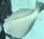


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_7.jpg: 224x640 (no detections), 13.7ms
Speed: 1.8ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2448_jpeg_jpg_7.jpg


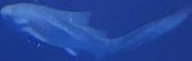


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2423_jpeg_jpg_1.jpg: 256x640 (no detections), 13.8ms
Speed: 1.7ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2423_jpeg_jpg_1.jpg


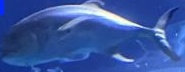


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_53.jpg: 320x640 (no detections), 15.8ms
Speed: 1.7ms preprocess, 15.8ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_53.jpg


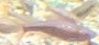


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_1.jpg: 320x640 (no detections), 12.3ms
Speed: 2.0ms preprocess, 12.3ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8420_jpg_1.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_7.jpg: 448x640 (no detections), 15.2ms
Speed: 2.4ms preprocess, 15.2ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8497_MOV-3_jpg_7.jpg


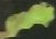


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_59.jpg: 448x640 (no detections), 15.7ms
Speed: 2.1ms preprocess, 15.7ms inference, 3.3ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8452_jpg_59.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_42.jpg: 320x640 (no detections), 20.7ms
Speed: 1.7ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_42.jpg


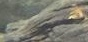


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_23.jpg: 640x544 (no detections), 18.0ms
Speed: 2.9ms preprocess, 18.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8452_jpg_23.jpg


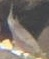


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_21.jpg: 256x640 (no detections), 17.7ms
Speed: 6.0ms preprocess, 17.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_21.jpg


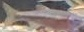


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_18.jpg: 640x480 (no detections), 14.1ms
Speed: 3.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8420_jpg_18.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_10.jpg: 640x384 (no detections), 13.6ms
Speed: 3.8ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2450_jpeg_jpg_10.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_6.jpg: 640x416 (no detections), 15.6ms
Speed: 7.5ms preprocess, 15.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2582_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8515_jpg_2.jpg: 640x544 1 frisbee, 22.6ms
Speed: 2.7ms preprocess, 22.6ms inference, 7.9ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8515_jpg_2.jpg


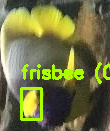


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_48.jpg: 224x640 (no detections), 15.9ms
Speed: 2.7ms preprocess, 15.9ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_8452_jpg_48.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2630_jpeg_jpg_2.jpg: 352x640 (no detections), 68.6ms
Speed: 1.7ms preprocess, 68.6ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2630_jpeg_jpg_2.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_1.jpg: 544x640 (no detections), 65.6ms
Speed: 5.0ms preprocess, 65.6ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8497_MOV-3_jpg_1.jpg


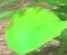


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_2.jpg: 640x512 (no detections), 13.2ms
Speed: 2.6ms preprocess, 13.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8404_jpg_2.jpg


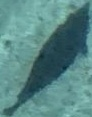


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2632_jpeg_jpg_3.jpg: 352x640 (no detections), 30.7ms
Speed: 1.9ms preprocess, 30.7ms inference, 0.8ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2632_jpeg_jpg_3.jpg


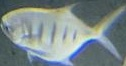


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_11.jpg: 320x640 (no detections), 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2570_jpeg_jpg_11.jpg


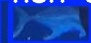


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_11.jpg: 640x224 (no detections), 107.2ms
Speed: 3.6ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8404_jpg_11.jpg


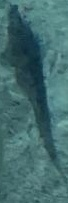


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_25.jpg: 384x640 (no detections), 40.2ms
Speed: 8.8ms preprocess, 40.2ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_25.jpg


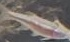


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2496_jpeg_jpg_0.jpg: 320x640 (no detections), 14.7ms
Speed: 1.7ms preprocess, 14.7ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2496_jpeg_jpg_0.jpg


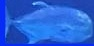


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_61.jpg: 480x640 (no detections), 26.0ms
Speed: 2.2ms preprocess, 26.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_61.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_62.jpg: 288x640 (no detections), 12.2ms
Speed: 2.1ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_62.jpg


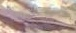


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_9.jpg: 384x640 (no detections), 40.0ms
Speed: 1.9ms preprocess, 40.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2582_jpeg_jpg_9.jpg


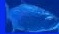


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_2.jpg: 288x640 (no detections), 34.4ms
Speed: 1.9ms preprocess, 34.4ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2448_jpeg_jpg_2.jpg


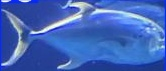


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_5.jpg: 608x640 (no detections), 26.7ms
Speed: 3.1ms preprocess, 26.7ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8513_MOV-0_jpg_5.jpg


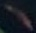


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_6.jpg: 640x320 (no detections), 18.4ms
Speed: 2.0ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_8404_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_8.jpg: 640x480 (no detections), 25.9ms
Speed: 2.3ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8420_jpg_8.jpg


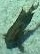


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_5.jpg: 416x640 (no detections), 18.9ms
Speed: 4.5ms preprocess, 18.9ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8582_MOV-0_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_6.jpg: 288x640 (no detections), 24.5ms
Speed: 8.7ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2450_jpeg_jpg_6.jpg


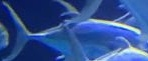


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_3.jpg: 544x640 1 frisbee, 21.6ms
Speed: 10.1ms preprocess, 21.6ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2448_jpeg_jpg_3.jpg


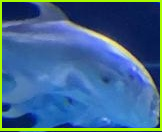


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_4.jpg: 256x640 (no detections), 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2448_jpeg_jpg_4.jpg


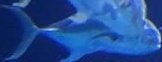


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_27.jpg: 320x640 (no detections), 11.1ms
Speed: 1.9ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_27.jpg


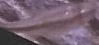


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2380_jpeg_jpg_3.jpg: 640x384 (no detections), 11.3ms
Speed: 2.0ms preprocess, 11.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2380_jpeg_jpg_3.jpg


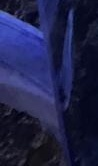


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_0.jpg: 640x512 (no detections), 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8404_jpg_0.jpg


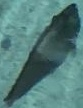


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_1.jpg: 320x640 (no detections), 11.4ms
Speed: 1.9ms preprocess, 11.4ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2499_jpeg_jpg_1.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_19.jpg: 320x640 (no detections), 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_19.jpg


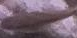


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_36.jpg: 416x640 (no detections), 13.3ms
Speed: 2.0ms preprocess, 13.3ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8452_jpg_36.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_4.jpg: 384x640 (no detections), 11.3ms
Speed: 2.0ms preprocess, 11.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2570_jpeg_jpg_4.jpg


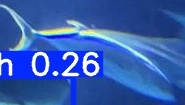


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_7.jpg: 416x640 (no detections), 13.1ms
Speed: 2.0ms preprocess, 13.1ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8452_jpg_7.jpg


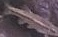


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_29.jpg: 320x640 (no detections), 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_29.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_28.jpg: 224x640 (no detections), 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_8452_jpg_28.jpg


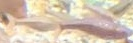


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_13.jpg: 640x576 (no detections), 14.0ms
Speed: 2.9ms preprocess, 14.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8497_MOV-5_jpg_13.jpg


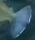


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_1.jpg: 416x640 (no detections), 15.2ms
Speed: 2.1ms preprocess, 15.2ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8582_MOV-0_jpg_1.jpg


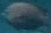


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_6.jpg: 480x640 1 cat, 14.9ms
Speed: 2.4ms preprocess, 14.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2395_jpeg_jpg_6.jpg


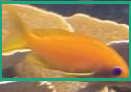


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8331_jpg_0.jpg: 640x544 1 person, 13.9ms
Speed: 4.6ms preprocess, 13.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8331_jpg_0.jpg


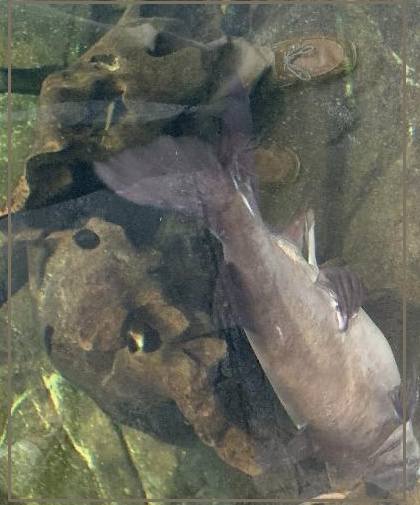


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_11.jpg: 416x640 (no detections), 11.9ms
Speed: 4.2ms preprocess, 11.9ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8420_jpg_11.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2446_jpeg_jpg_4.jpg: 320x640 (no detections), 12.5ms
Speed: 1.9ms preprocess, 12.5ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2446_jpeg_jpg_4.jpg


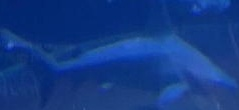


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_3129_jpeg_jpg_0.jpg: 640x640 1 cat, 14.4ms
Speed: 3.7ms preprocess, 14.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_3129_jpeg_jpg_0.jpg


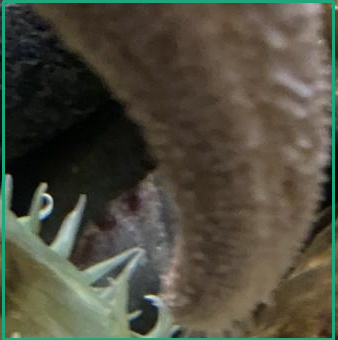


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_9.jpg: 448x640 (no detections), 11.7ms
Speed: 2.5ms preprocess, 11.7ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2450_jpeg_jpg_9.jpg


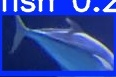


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_8.jpg: 544x640 (no detections), 13.8ms
Speed: 4.6ms preprocess, 13.8ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8452_jpg_8.jpg


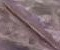


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2496_jpeg_jpg_5.jpg: 320x640 (no detections), 10.8ms
Speed: 1.7ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2496_jpeg_jpg_5.jpg


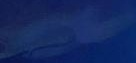


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_22.jpg: 640x608 (no detections), 14.1ms
Speed: 3.0ms preprocess, 14.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8452_jpg_22.jpg


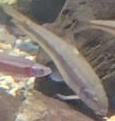


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_5.jpg: 320x640 (no detections), 10.5ms
Speed: 1.8ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8395_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_1.jpg: 416x640 1 person, 11.3ms
Speed: 2.4ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2395_jpeg_jpg_1.jpg


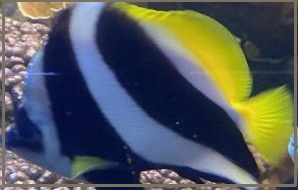


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_22.jpg: 640x448 (no detections), 10.8ms
Speed: 2.1ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8420_jpg_22.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_4.jpg: 640x192 (no detections), 60.1ms
Speed: 1.2ms preprocess, 60.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 192)
Predictions for: IMG_8404_jpg_4.jpg


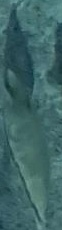


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_11.jpg: 256x640 (no detections), 10.0ms
Speed: 1.8ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2450_jpeg_jpg_11.jpg


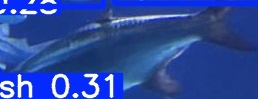


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_8.jpg: 448x640 (no detections), 11.6ms
Speed: 2.1ms preprocess, 11.6ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2450_jpeg_jpg_8.jpg


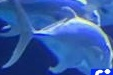


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_6.jpg: 320x640 (no detections), 9.9ms
Speed: 1.6ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-0_jpg_6.jpg


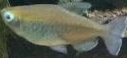


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_5.jpg: 640x640 (no detections), 14.4ms
Speed: 3.1ms preprocess, 14.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8497_MOV-0_jpg_5.jpg


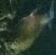


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_13.jpg: 448x640 (no detections), 11.5ms
Speed: 2.2ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2450_jpeg_jpg_13.jpg


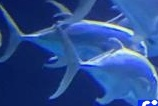


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_4.jpg: 576x640 (no detections), 14.0ms
Speed: 4.0ms preprocess, 14.0ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8513_MOV-0_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_8.jpg: 640x480 (no detections), 10.8ms
Speed: 2.1ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2582_jpeg_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_7.jpg: 640x480 (no detections), 10.0ms
Speed: 3.1ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8404_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_63.jpg: 352x640 (no detections), 10.8ms
Speed: 1.7ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8452_jpg_63.jpg


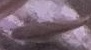


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2496_jpeg_jpg_6.jpg: 384x640 (no detections), 9.8ms
Speed: 1.7ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2496_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_1.jpg: 288x640 (no detections), 9.6ms
Speed: 1.5ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8513_MOV-0_jpg_1.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_41.jpg: 448x640 (no detections), 11.5ms
Speed: 2.5ms preprocess, 11.5ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8452_jpg_41.jpg


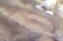


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_6.jpg: 544x640 (no detections), 11.5ms
Speed: 2.5ms preprocess, 11.5ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8497_MOV-5_jpg_6.jpg


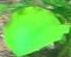


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2434_jpeg_jpg_0.jpg: 608x640 1 person, 12.1ms
Speed: 3.3ms preprocess, 12.1ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2434_jpeg_jpg_0.jpg


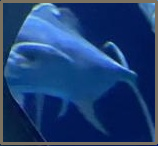


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2423_jpeg_jpg_2.jpg: 288x640 (no detections), 9.6ms
Speed: 1.5ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2423_jpeg_jpg_2.jpg


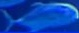


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2547_jpeg_jpg_1.jpg: 640x448 (no detections), 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_2547_jpeg_jpg_1.jpg


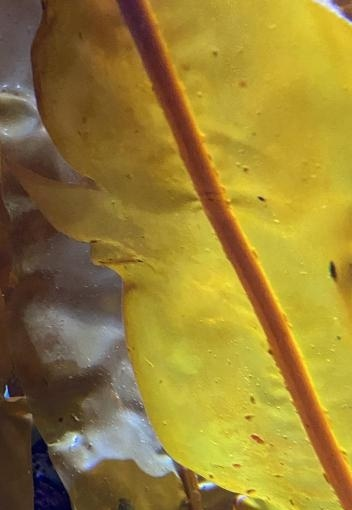


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2630_jpeg_jpg_3.jpg: 640x352 (no detections), 14.0ms
Speed: 1.8ms preprocess, 14.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_2630_jpeg_jpg_3.jpg


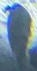


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-5_jpg_0.jpg: 256x640 (no detections), 9.7ms
Speed: 1.4ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8582_MOV-5_jpg_0.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_13.jpg: 416x640 (no detections), 9.5ms
Speed: 1.9ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8404_jpg_13.jpg


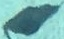


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_21.jpg: 576x640 (no detections), 11.4ms
Speed: 2.7ms preprocess, 11.4ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8420_jpg_21.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_17.jpg: 352x640 (no detections), 8.8ms
Speed: 1.6ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8452_jpg_17.jpg


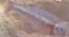


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_4.jpg: 352x640 (no detections), 8.9ms
Speed: 1.8ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2499_jpeg_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_37.jpg: 640x608 (no detections), 11.5ms
Speed: 2.8ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8452_jpg_37.jpg


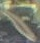


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_15.jpg: 384x640 (no detections), 10.8ms
Speed: 1.7ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8420_jpg_15.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_9.jpg: 416x640 (no detections), 9.4ms
Speed: 1.8ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8396_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_2.jpg: 640x640 (no detections), 14.0ms
Speed: 3.1ms preprocess, 14.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8513_MOV-0_jpg_2.jpg


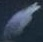


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_12.jpg: 384x640 (no detections), 10.4ms
Speed: 2.1ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_12.jpg


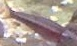


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_9.jpg: 640x576 (no detections), 11.4ms
Speed: 3.0ms preprocess, 11.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8404_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_9.jpg: 640x416 (no detections), 9.4ms
Speed: 2.4ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8497_MOV-3_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_11.jpg: 320x640 (no detections), 9.0ms
Speed: 2.1ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_11.jpg


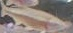


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_9.jpg: 288x640 (no detections), 17.1ms
Speed: 1.5ms preprocess, 17.1ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2371_jpeg_jpg_2.jpg: 384x640 (no detections), 15.2ms
Speed: 2.3ms preprocess, 15.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2371_jpeg_jpg_2.jpg


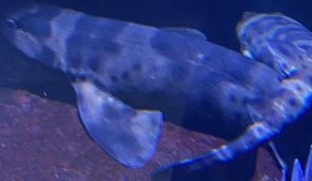


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_6.jpg: 256x640 (no detections), 10.8ms
Speed: 1.8ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2499_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_3.jpg: 352x640 (no detections), 15.1ms
Speed: 2.0ms preprocess, 15.1ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2450_jpeg_jpg_3.jpg


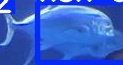


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_58.jpg: 384x640 (no detections), 10.1ms
Speed: 1.9ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_58.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_3.jpg: 384x640 (no detections), 8.5ms
Speed: 1.9ms preprocess, 8.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8420_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_3.jpg: 608x640 1 cat, 10.8ms
Speed: 3.6ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2395_jpeg_jpg_3.jpg


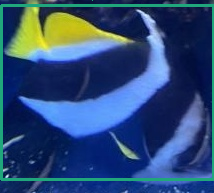


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_4.jpg: 640x384 (no detections), 10.4ms
Speed: 2.0ms preprocess, 10.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8497_MOV-3_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_6.jpg: 256x640 (no detections), 10.4ms
Speed: 1.5ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2448_jpeg_jpg_6.jpg


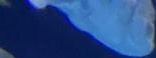


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_34.jpg: 608x640 (no detections), 10.9ms
Speed: 4.7ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8452_jpg_34.jpg


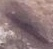


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_5.jpg: 640x448 (no detections), 10.1ms
Speed: 3.2ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_2582_jpeg_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_2.jpg: 640x576 (no detections), 10.9ms
Speed: 4.4ms preprocess, 10.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8497_MOV-0_jpg_2.jpg


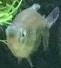


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_9.jpg: 384x640 (no detections), 9.4ms
Speed: 2.3ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2570_jpeg_jpg_9.jpg


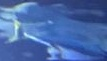


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2434_jpeg_jpg_2.jpg: 640x224 1 person, 11.7ms
Speed: 3.2ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_2434_jpeg_jpg_2.jpg


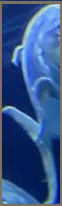


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_12.jpg: 320x640 (no detections), 10.2ms
Speed: 1.7ms preprocess, 10.2ms inference, 2.1ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8420_jpg_12.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2446_jpeg_jpg_3.jpg: 320x640 (no detections), 8.7ms
Speed: 1.7ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2446_jpeg_jpg_3.jpg


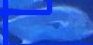


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_5.jpg: 512x640 (no detections), 61.7ms
Speed: 2.6ms preprocess, 61.7ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2395_jpeg_jpg_5.jpg


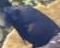


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_6.jpg: 640x480 (no detections), 9.3ms
Speed: 2.3ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8513_MOV-0_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_2.jpg: 288x640 (no detections), 8.6ms
Speed: 1.7ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2450_jpeg_jpg_2.jpg


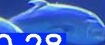


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8515_jpg_3.jpg: 640x544 (no detections), 10.5ms
Speed: 2.9ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8515_jpg_3.jpg


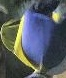


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_33.jpg: 320x640 (no detections), 9.3ms
Speed: 1.8ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_33.jpg


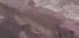


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_24.jpg: 512x640 (no detections), 8.9ms
Speed: 2.4ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8420_jpg_24.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_1.jpg: 352x640 (no detections), 8.9ms
Speed: 1.8ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8497_MOV-0_jpg_1.jpg


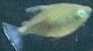


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_4.jpg: 352x640 (no detections), 8.0ms
Speed: 1.7ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8497_MOV-5_jpg_4.jpg


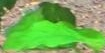


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_49.jpg: 640x384 (no detections), 8.8ms
Speed: 1.8ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8452_jpg_49.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_2.jpg: 352x640 (no detections), 8.7ms
Speed: 1.7ms preprocess, 8.7ms inference, 0.5ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8420_jpg_2.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_4.jpg: 384x640 (no detections), 9.9ms
Speed: 2.0ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_4.jpg


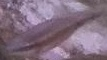


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-5_jpg_1.jpg: 608x640 (no detections), 10.7ms
Speed: 2.9ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8582_MOV-5_jpg_1.jpg


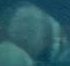


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_8.jpg: 448x640 (no detections), 9.1ms
Speed: 2.2ms preprocess, 9.1ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8497_MOV-5_jpg_8.jpg


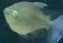


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_30.jpg: 224x640 (no detections), 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_8452_jpg_30.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_7.jpg: 352x640 (no detections), 8.4ms
Speed: 1.8ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8582_MOV-0_jpg_7.jpg


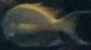


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_10.jpg: 480x640 (no detections), 9.3ms
Speed: 2.2ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8497_MOV-3_jpg_10.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2371_jpeg_jpg_1.jpg: 256x640 (no detections), 8.3ms
Speed: 1.7ms preprocess, 8.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2371_jpeg_jpg_1.jpg


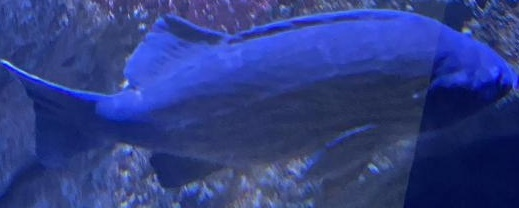


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_13.jpg: 480x640 (no detections), 10.0ms
Speed: 2.3ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_13.jpg


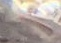


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_4.jpg: 288x640 (no detections), 8.7ms
Speed: 1.5ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8420_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8343_jpg_0.jpg: 640x512 (no detections), 9.0ms
Speed: 2.6ms preprocess, 9.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8343_jpg_0.jpg


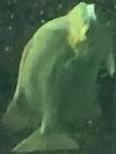


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_38.jpg: 320x640 (no detections), 9.3ms
Speed: 1.6ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_38.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_45.jpg: 352x640 (no detections), 8.9ms
Speed: 1.7ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8452_jpg_45.jpg


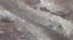


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_14.jpg: 320x640 (no detections), 8.7ms
Speed: 4.4ms preprocess, 8.7ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_14.jpg


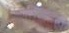


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_5.jpg: 544x640 (no detections), 10.5ms
Speed: 2.7ms preprocess, 10.5ms inference, 0.5ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8497_MOV-5_jpg_5.jpg


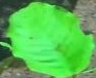


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_54.jpg: 480x640 (no detections), 9.2ms
Speed: 2.3ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_54.jpg


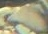


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_0.jpg: 544x640 (no detections), 10.6ms
Speed: 2.6ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8497_MOV-3_jpg_0.jpg


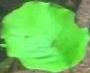


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_7.jpg: 384x640 (no detections), 9.1ms
Speed: 1.8ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2450_jpeg_jpg_7.jpg


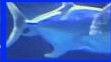


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2630_jpeg_jpg_1.jpg: 640x224 (no detections), 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_2630_jpeg_jpg_1.jpg


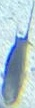


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_32.jpg: 384x640 (no detections), 8.7ms
Speed: 1.8ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_32.jpg


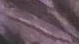


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_6.jpg: 256x640 (no detections), 8.8ms
Speed: 1.4ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8395_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_7.jpg: 288x640 (no detections), 13.6ms
Speed: 1.8ms preprocess, 13.6ms inference, 2.9ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8396_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_6.jpg: 320x640 (no detections), 10.7ms
Speed: 1.6ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8420_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_18.jpg: 608x640 (no detections), 13.1ms
Speed: 3.2ms preprocess, 13.1ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8452_jpg_18.jpg


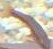


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_6.jpg: 352x640 (no detections), 17.4ms
Speed: 1.9ms preprocess, 17.4ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8582_MOV-0_jpg_6.jpg


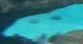


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_2.jpg: 512x640 (no detections), 11.9ms
Speed: 2.3ms preprocess, 11.9ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2499_jpeg_jpg_2.jpg


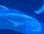


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_16.jpg: 288x640 (no detections), 9.8ms
Speed: 1.5ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_16.jpg


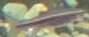


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_3.jpg: 320x640 (no detections), 9.1ms
Speed: 1.6ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-5_jpg_3.jpg


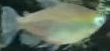


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_57.jpg: 256x640 (no detections), 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_57.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_8.jpg: 640x576 (no detections), 10.6ms
Speed: 2.4ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8395_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_12.jpg: 512x640 (no detections), 9.5ms
Speed: 2.3ms preprocess, 9.5ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8497_MOV-5_jpg_12.jpg


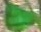


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2446_jpeg_jpg_1.jpg: 288x640 (no detections), 9.4ms
Speed: 1.5ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2446_jpeg_jpg_1.jpg


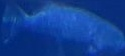


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2632_jpeg_jpg_1.jpg: 576x640 (no detections), 10.6ms
Speed: 2.9ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2632_jpeg_jpg_1.jpg


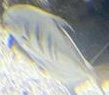


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_1.jpg: 480x640 (no detections), 12.1ms
Speed: 2.4ms preprocess, 12.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_1.jpg


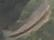


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_50.jpg: 640x512 (no detections), 8.6ms
Speed: 2.4ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8452_jpg_50.jpg


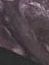


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_8.jpg: 384x640 (no detections), 9.6ms
Speed: 1.7ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8396_jpg_8.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8515_jpg_1.jpg: 640x480 (no detections), 10.8ms
Speed: 2.3ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8515_jpg_1.jpg


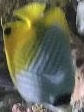


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_2.jpg: 640x640 (no detections), 11.0ms
Speed: 3.1ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8497_MOV-3_jpg_2.jpg


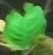


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_10.jpg: 416x640 (no detections), 9.4ms
Speed: 2.1ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2570_jpeg_jpg_10.jpg


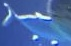


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8515_jpg_0.jpg: 608x640 (no detections), 10.7ms
Speed: 2.8ms preprocess, 10.7ms inference, 0.5ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8515_jpg_0.jpg


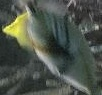


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_13.jpg: 288x640 (no detections), 9.1ms
Speed: 1.5ms preprocess, 9.1ms inference, 0.5ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8420_jpg_13.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2379_jpeg_jpg_0.jpg: 640x256 (no detections), 60.4ms
Speed: 1.5ms preprocess, 60.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_2379_jpeg_jpg_0.jpg


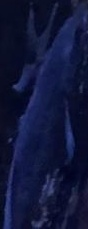


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_47.jpg: 256x640 (no detections), 9.7ms
Speed: 1.5ms preprocess, 9.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_47.jpg


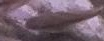


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_5.jpg: 320x640 (no detections), 10.3ms
Speed: 1.9ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2450_jpeg_jpg_5.jpg


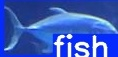


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_0.jpg: 640x608 (no detections), 10.4ms
Speed: 3.4ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2395_jpeg_jpg_0.jpg


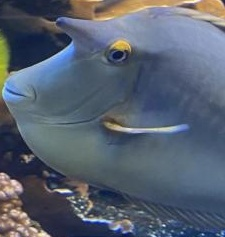


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_5.jpg: 480x640 (no detections), 8.9ms
Speed: 2.2ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_5.jpg


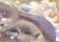


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_15.jpg: 480x640 (no detections), 9.3ms
Speed: 2.3ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_15.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_17.jpg: 640x640 (no detections), 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8420_jpg_17.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_7.jpg: 320x640 2 cars, 9.4ms
Speed: 1.7ms preprocess, 9.4ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-5_jpg_7.jpg


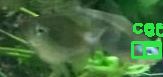


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_4.jpg: 576x640 (no detections), 13.7ms
Speed: 2.9ms preprocess, 13.7ms inference, 0.5ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8582_MOV-0_jpg_4.jpg


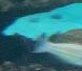


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_5.jpg: 320x640 (no detections), 10.5ms
Speed: 1.7ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-3_jpg_5.jpg


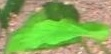


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_19.jpg: 640x576 (no detections), 12.4ms
Speed: 2.7ms preprocess, 12.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8420_jpg_19.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_52.jpg: 384x640 (no detections), 9.0ms
Speed: 2.0ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8452_jpg_52.jpg


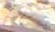


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_7.jpg: 480x640 (no detections), 9.1ms
Speed: 3.2ms preprocess, 9.1ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8497_MOV-0_jpg_7.jpg


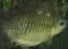


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_20.jpg: 256x640 (no detections), 10.5ms
Speed: 1.4ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_20.jpg


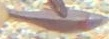


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2379_jpeg_jpg_1.jpg: 640x640 1 person, 10.6ms
Speed: 3.8ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2379_jpeg_jpg_1.jpg


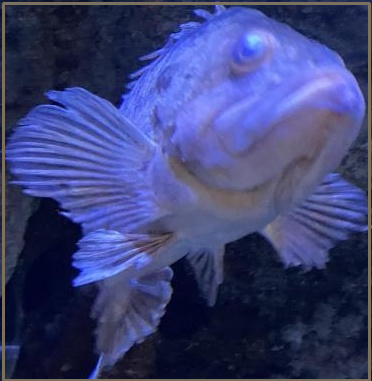


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8513_MOV-0_jpg_0.jpg: 320x640 1 bird, 13.4ms
Speed: 2.1ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8513_MOV-0_jpg_0.jpg


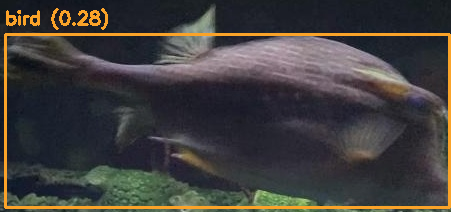


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_5.jpg: 448x640 1 person, 12.0ms
Speed: 2.6ms preprocess, 12.0ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2448_jpeg_jpg_5.jpg


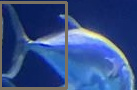


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_8.jpg: 640x288 1 person, 69.3ms
Speed: 3.6ms preprocess, 69.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 288)
Predictions for: IMG_2570_jpeg_jpg_8.jpg


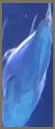


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_20.jpg: 352x640 (no detections), 12.2ms
Speed: 1.8ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8420_jpg_20.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_4.jpg: 640x384 (no detections), 12.7ms
Speed: 2.0ms preprocess, 12.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8395_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2380_jpeg_jpg_1.jpg: 640x320 (no detections), 12.5ms
Speed: 1.9ms preprocess, 12.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_2380_jpeg_jpg_1.jpg


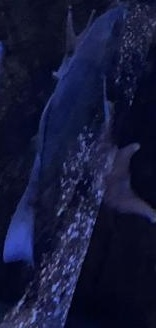


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_7.jpg: 288x640 (no detections), 11.6ms
Speed: 5.0ms preprocess, 11.6ms inference, 0.9ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8420_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_0.jpg: 640x640 1 cat, 11.3ms
Speed: 3.5ms preprocess, 11.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8497_MOV-5_jpg_0.jpg


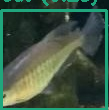


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_12.jpg: 320x640 (no detections), 12.1ms
Speed: 1.7ms preprocess, 12.1ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2450_jpeg_jpg_12.jpg


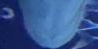


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_51.jpg: 480x640 (no detections), 11.9ms
Speed: 4.3ms preprocess, 11.9ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_51.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_0.jpg: 448x640 (no detections), 15.2ms
Speed: 2.3ms preprocess, 15.2ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2450_jpeg_jpg_0.jpg


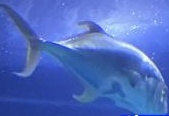


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_12.jpg: 320x640 (no detections), 15.6ms
Speed: 3.7ms preprocess, 15.6ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2570_jpeg_jpg_12.jpg


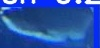


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_56.jpg: 480x640 1 cat, 13.2ms
Speed: 2.4ms preprocess, 13.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_56.jpg


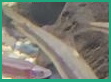


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_1.jpg: 256x640 (no detections), 16.7ms
Speed: 2.5ms preprocess, 16.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2448_jpeg_jpg_1.jpg


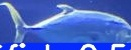


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_13.jpg: 320x640 (no detections), 11.1ms
Speed: 1.8ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8395_jpg_13.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2371_jpeg_jpg_0.jpg: 416x640 (no detections), 11.6ms
Speed: 2.4ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2371_jpeg_jpg_0.jpg


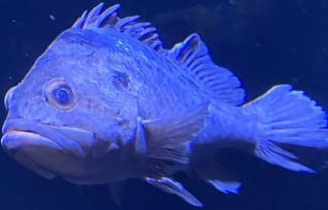


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_6.jpg: 416x640 (no detections), 11.7ms
Speed: 2.4ms preprocess, 11.7ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2570_jpeg_jpg_6.jpg


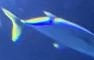


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2632_jpeg_jpg_5.jpg: 576x640 (no detections), 12.2ms
Speed: 3.0ms preprocess, 12.2ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2632_jpeg_jpg_5.jpg


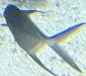


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_39.jpg: 416x640 (no detections), 13.2ms
Speed: 1.9ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8452_jpg_39.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_4.jpg: 320x640 (no detections), 9.4ms
Speed: 3.1ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-0_jpg_4.jpg


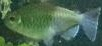


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_40.jpg: 288x640 (no detections), 10.1ms
Speed: 1.5ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_40.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2423_jpeg_jpg_6.jpg: 640x384 (no detections), 10.8ms
Speed: 1.9ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2423_jpeg_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_10.jpg: 288x640 (no detections), 8.8ms
Speed: 1.5ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8497_MOV-5_jpg_10.jpg


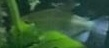


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_2.jpg: 640x640 (no detections), 10.7ms
Speed: 3.3ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2570_jpeg_jpg_2.jpg


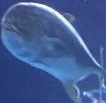


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_3.jpg: 288x640 (no detections), 9.1ms
Speed: 1.6ms preprocess, 9.1ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2582_jpeg_jpg_3.jpg


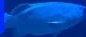


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8343_jpg_1.jpg: 608x640 (no detections), 10.3ms
Speed: 3.1ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8343_jpg_1.jpg


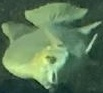


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_5.jpg: 640x480 (no detections), 9.6ms
Speed: 2.3ms preprocess, 9.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8396_jpg_5.jpg


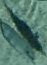


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_5.jpg: 288x640 (no detections), 19.4ms
Speed: 1.6ms preprocess, 19.4ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2499_jpeg_jpg_5.jpg


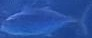


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_35.jpg: 640x416 (no detections), 15.6ms
Speed: 2.3ms preprocess, 15.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8452_jpg_35.jpg


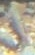


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2582_jpeg_jpg_11.jpg: 128x640 (no detections), 95.2ms
Speed: 0.8ms preprocess, 95.2ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 640)
Predictions for: IMG_2582_jpeg_jpg_11.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2380_jpeg_jpg_0.jpg: 512x640 (no detections), 14.1ms
Speed: 3.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2380_jpeg_jpg_0.jpg


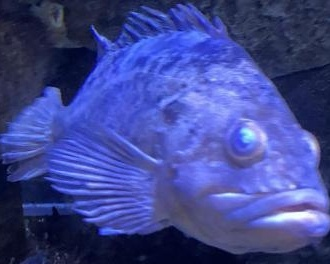


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_60.jpg: 640x640 (no detections), 11.7ms
Speed: 3.2ms preprocess, 11.7ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8452_jpg_60.jpg


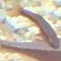


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_7.jpg: 640x512 (no detections), 12.7ms
Speed: 2.7ms preprocess, 12.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_2499_jpeg_jpg_7.jpg


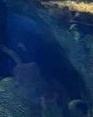


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_2.jpg: 256x640 (no detections), 10.0ms
Speed: 1.5ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_2.jpg


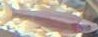


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_2.jpg: 608x640 (no detections), 13.7ms
Speed: 3.4ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2395_jpeg_jpg_2.jpg


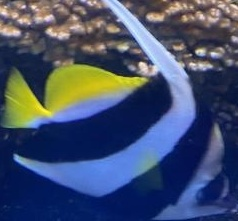


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_0.jpg: 480x640 (no detections), 13.8ms
Speed: 2.5ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8452_jpg_0.jpg


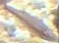


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_8.jpg: 512x640 (no detections), 10.6ms
Speed: 2.4ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8497_MOV-0_jpg_8.jpg


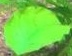


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_3.jpg: 288x640 (no detections), 13.3ms
Speed: 1.5ms preprocess, 13.3ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_3.jpg


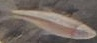


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-0_jpg_0.jpg: 448x640 (no detections), 10.1ms
Speed: 2.1ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8497_MOV-0_jpg_0.jpg


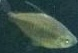


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2395_jpeg_jpg_4.jpg: 608x640 (no detections), 14.4ms
Speed: 3.0ms preprocess, 14.4ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2395_jpeg_jpg_4.jpg


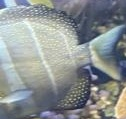


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_26.jpg: 576x640 (no detections), 16.1ms
Speed: 5.2ms preprocess, 16.1ms inference, 3.2ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8452_jpg_26.jpg


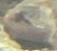


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_6.jpg: 384x640 (no detections), 12.8ms
Speed: 3.9ms preprocess, 12.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8396_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_3.jpg: 640x384 (no detections), 10.7ms
Speed: 3.6ms preprocess, 10.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8497_MOV-3_jpg_3.jpg


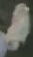


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_16.jpg: 448x640 (no detections), 11.2ms
Speed: 2.1ms preprocess, 11.2ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8420_jpg_16.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_44.jpg: 640x416 (no detections), 10.6ms
Speed: 1.9ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8452_jpg_44.jpg


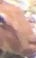


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_9.jpg: 640x224 (no detections), 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8497_MOV-5_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_1.jpg: 416x640 (no detections), 10.5ms
Speed: 2.8ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8497_MOV-5_jpg_1.jpg


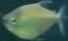


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_14.jpg: 320x640 (no detections), 13.8ms
Speed: 1.8ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8420_jpg_14.jpg


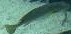


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_11.jpg: 608x640 (no detections), 12.8ms
Speed: 2.9ms preprocess, 12.8ms inference, 4.5ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8497_MOV-3_jpg_11.jpg


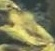


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_6.jpg: 640x480 (no detections), 15.5ms
Speed: 2.4ms preprocess, 15.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8497_MOV-3_jpg_6.jpg


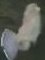


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_10.jpg: 320x640 (no detections), 13.0ms
Speed: 1.7ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8452_jpg_10.jpg


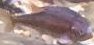


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2499_jpeg_jpg_3.jpg: 224x640 (no detections), 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2499_jpeg_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_24.jpg: 352x640 (no detections), 9.9ms
Speed: 1.8ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8452_jpg_24.jpg


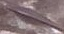


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2380_jpeg_jpg_2.jpg: 640x256 (no detections), 9.8ms
Speed: 1.6ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_2380_jpeg_jpg_2.jpg


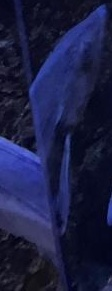


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2434_jpeg_jpg_1.jpg: 640x608 (no detections), 11.6ms
Speed: 2.9ms preprocess, 11.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2434_jpeg_jpg_1.jpg


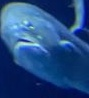


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2423_jpeg_jpg_5.jpg: 448x640 (no detections), 11.8ms
Speed: 2.3ms preprocess, 11.8ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2423_jpeg_jpg_5.jpg


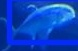


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_6.jpg: 288x640 (no detections), 9.9ms
Speed: 1.9ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8452_jpg_6.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_1.jpg: 640x416 1 person, 12.8ms
Speed: 2.4ms preprocess, 12.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2570_jpeg_jpg_1.jpg


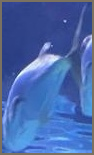


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2496_jpeg_jpg_7.jpg: 256x640 (no detections), 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2496_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_8.jpg: 640x256 (no detections), 10.7ms
Speed: 1.6ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_8404_jpg_8.jpg


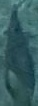


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_5.jpg: 576x640 (no detections), 12.0ms
Speed: 3.0ms preprocess, 12.0ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8420_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_4.jpg: 576x640 (no detections), 11.1ms
Speed: 2.9ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2450_jpeg_jpg_4.jpg


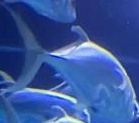


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8515_jpg_4.jpg: 640x352 (no detections), 10.0ms
Speed: 2.2ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_8515_jpg_4.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2632_jpeg_jpg_2.jpg: 512x640 1 cat, 11.6ms
Speed: 3.0ms preprocess, 11.6ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2632_jpeg_jpg_2.jpg


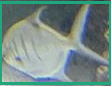


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_11.jpg: 192x640 (no detections), 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 640)
Predictions for: IMG_8497_MOV-5_jpg_11.jpg


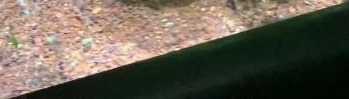


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-3_jpg_8.jpg: 640x544 (no detections), 13.6ms
Speed: 2.9ms preprocess, 13.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8497_MOV-3_jpg_8.jpg


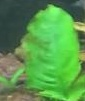


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_43.jpg: 640x448 (no detections), 10.8ms
Speed: 4.2ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8452_jpg_43.jpg


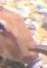


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8497_MOV-5_jpg_2.jpg: 320x640 (no detections), 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8497_MOV-5_jpg_2.jpg


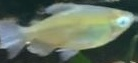


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2423_jpeg_jpg_4.jpg: 320x640 (no detections), 8.5ms
Speed: 1.6ms preprocess, 8.5ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2423_jpeg_jpg_4.jpg


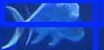


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_46.jpg: 416x640 (no detections), 9.3ms
Speed: 2.1ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8452_jpg_46.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2448_jpeg_jpg_9.jpg: 416x640 (no detections), 8.6ms
Speed: 2.2ms preprocess, 8.6ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2448_jpeg_jpg_9.jpg


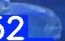


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8395_jpg_9.jpg: 640x288 (no detections), 9.8ms
Speed: 1.4ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 288)
Predictions for: IMG_8395_jpg_9.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_2.jpg: 640x640 (no detections), 11.9ms
Speed: 3.0ms preprocess, 11.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8582_MOV-0_jpg_2.jpg


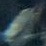


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8404_jpg_5.jpg: 640x224 (no detections), 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8404_jpg_5.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_55.jpg: 352x640 (no detections), 11.0ms
Speed: 1.6ms preprocess, 11.0ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8452_jpg_55.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8420_jpg_23.jpg: 352x640 (no detections), 10.7ms
Speed: 1.7ms preprocess, 10.7ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8420_jpg_23.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2450_jpeg_jpg_14.jpg: 224x640 (no detections), 11.1ms
Speed: 1.4ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2450_jpeg_jpg_14.jpg


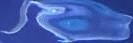


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_2570_jpeg_jpg_5.jpg: 480x640 (no detections), 11.7ms
Speed: 2.3ms preprocess, 11.7ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2570_jpeg_jpg_5.jpg


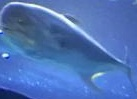


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8396_jpg_3.jpg: 640x480 (no detections), 10.6ms
Speed: 2.3ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8396_jpg_3.jpg


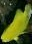


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_3.jpg: 320x640 (no detections), 11.3ms
Speed: 1.6ms preprocess, 11.3ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8582_MOV-0_jpg_3.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8582_MOV-0_jpg_0.jpg: 640x640 (no detections), 18.0ms
Speed: 4.0ms preprocess, 18.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8582_MOV-0_jpg_0.jpg


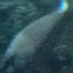


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8452_jpg_31.jpg: 256x640 (no detections), 19.5ms
Speed: 1.5ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8452_jpg_31.jpg


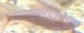


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/fish/IMG_8331_jpg_1.jpg: 640x544 1 person, 13.3ms
Speed: 5.9ms preprocess, 13.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8331_jpg_1.jpg


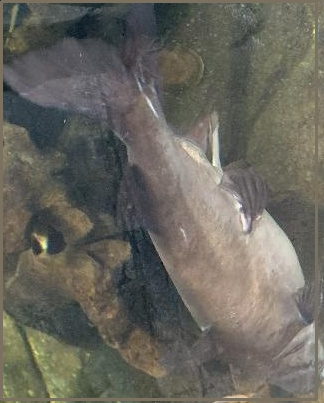

In [78]:
#Adding colours and confidence scores to it -- FISH
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/fish/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_0.jpg: 608x640 (no detections), 19.3ms
Speed: 2.9ms preprocess, 19.3ms inference, 4.4ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8490_jpg_0.jpg


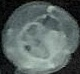


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_23.jpg: 480x640 (no detections), 14.8ms
Speed: 2.6ms preprocess, 14.8ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8595_MOV-0_jpg_23.jpg


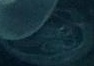


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_39.jpg: 640x512 (no detections), 16.9ms
Speed: 2.4ms preprocess, 16.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_39.jpg


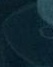


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_3.jpg: 640x448 (no detections), 13.2ms
Speed: 3.3ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8595_MOV-0_jpg_3.jpg


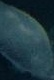


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_47.jpg: 608x640 (no detections), 17.6ms
Speed: 2.9ms preprocess, 17.6ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8490_jpg_47.jpg


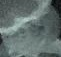


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_12.jpg: 352x640 (no detections), 14.1ms
Speed: 2.0ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8595_MOV-0_jpg_12.jpg


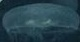


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_41.jpg: 640x640 (no detections), 16.9ms
Speed: 3.4ms preprocess, 16.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_41.jpg


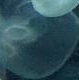


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_0.jpg: 640x416 (no detections), 16.2ms
Speed: 2.2ms preprocess, 16.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2465_jpeg_jpg_0.jpg


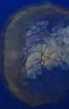


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_11.jpg: 320x640 (no detections), 13.5ms
Speed: 1.8ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2470_jpeg_jpg_11.jpg


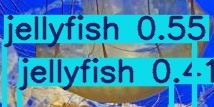


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2477_jpeg_jpg_1.jpg: 416x640 (no detections), 19.1ms
Speed: 2.4ms preprocess, 19.1ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2477_jpeg_jpg_1.jpg


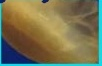


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_5.jpg: 640x384 (no detections), 14.1ms
Speed: 5.3ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8595_MOV-0_jpg_5.jpg


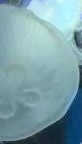


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8599_MOV-3_jpg_3.jpg: 640x320 (no detections), 16.2ms
Speed: 1.8ms preprocess, 16.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_8599_MOV-3_jpg_3.jpg


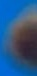


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_6.jpg: 320x640 (no detections), 14.1ms
Speed: 5.3ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2574_jpeg_jpg_6.jpg


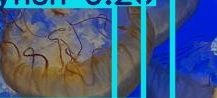


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_30.jpg: 608x640 (no detections), 19.3ms
Speed: 2.9ms preprocess, 19.3ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8490_jpg_30.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_16.jpg: 640x608 (no detections), 15.8ms
Speed: 3.5ms preprocess, 15.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8490_jpg_16.jpg


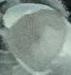


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_2.jpg: 512x640 1 cow, 15.3ms
Speed: 3.8ms preprocess, 15.3ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2465_jpeg_jpg_2.jpg


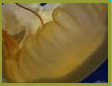


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_35.jpg: 608x640 (no detections), 24.2ms
Speed: 2.7ms preprocess, 24.2ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8595_MOV-0_jpg_35.jpg


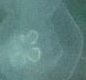


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_19.jpg: 640x416 (no detections), 22.8ms
Speed: 2.2ms preprocess, 22.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8490_jpg_19.jpg


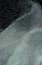


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_14.jpg: 512x640 (no detections), 14.9ms
Speed: 3.2ms preprocess, 14.9ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8490_jpg_14.jpg


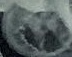


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_4.jpg: 416x640 1 cat, 17.5ms
Speed: 2.9ms preprocess, 17.5ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2465_jpeg_jpg_4.jpg


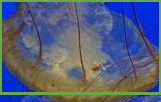


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_0.jpg: 640x480 1 cat, 26.2ms
Speed: 2.8ms preprocess, 26.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2470_jpeg_jpg_0.jpg


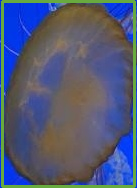


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_16.jpg: 544x640 1 cat, 33.4ms
Speed: 2.8ms preprocess, 33.4ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8595_MOV-0_jpg_16.jpg


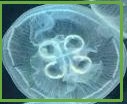


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_51.jpg: 640x544 (no detections), 25.2ms
Speed: 8.7ms preprocess, 25.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8490_jpg_51.jpg


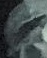


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_7.jpg: 640x416 (no detections), 13.9ms
Speed: 2.9ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2574_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_11.jpg: 544x640 (no detections), 15.2ms
Speed: 3.4ms preprocess, 15.2ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2465_jpeg_jpg_11.jpg


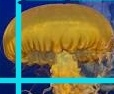


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_38.jpg: 640x480 (no detections), 12.2ms
Speed: 3.7ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8595_MOV-0_jpg_38.jpg


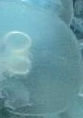


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_18.jpg: 320x640 (no detections), 20.3ms
Speed: 1.7ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8490_jpg_18.jpg


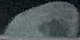


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_7.jpg: 384x640 (no detections), 12.2ms
Speed: 2.2ms preprocess, 12.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2465_jpeg_jpg_7.jpg


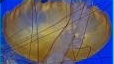


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_9.jpg: 480x640 (no detections), 13.1ms
Speed: 2.6ms preprocess, 13.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8490_jpg_9.jpg


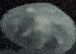


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_2.jpg: 608x640 (no detections), 15.3ms
Speed: 3.0ms preprocess, 15.3ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2468_jpeg_jpg_2.jpg


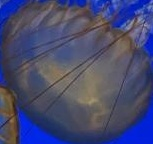


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_33.jpg: 512x640 (no detections), 13.0ms
Speed: 4.0ms preprocess, 13.0ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8490_jpg_33.jpg


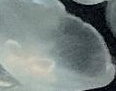


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_32.jpg: 352x640 (no detections), 30.4ms
Speed: 5.1ms preprocess, 30.4ms inference, 6.9ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8595_MOV-0_jpg_32.jpg


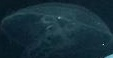


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_7.jpg: 352x640 (no detections), 31.5ms
Speed: 4.2ms preprocess, 31.5ms inference, 9.1ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2468_jpeg_jpg_7.jpg


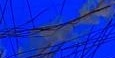


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_12.jpg: 640x608 1 cake, 37.4ms
Speed: 3.0ms preprocess, 37.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2465_jpeg_jpg_12.jpg


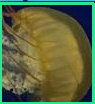


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_4.jpg: 640x416 (no detections), 34.3ms
Speed: 2.0ms preprocess, 34.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2470_jpeg_jpg_4.jpg


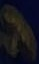


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_24.jpg: 448x640 (no detections), 30.0ms
Speed: 2.3ms preprocess, 30.0ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8595_MOV-0_jpg_24.jpg


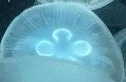


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_44.jpg: 448x640 (no detections), 23.5ms
Speed: 2.4ms preprocess, 23.5ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8490_jpg_44.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_39.jpg: 640x640 1 car, 25.4ms
Speed: 8.8ms preprocess, 25.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_39.jpg


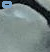


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_15.jpg: 640x608 (no detections), 30.9ms
Speed: 5.2ms preprocess, 30.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8595_MOV-0_jpg_15.jpg


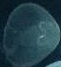


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_1.jpg: 448x640 (no detections), 30.6ms
Speed: 2.6ms preprocess, 30.6ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2470_jpeg_jpg_1.jpg


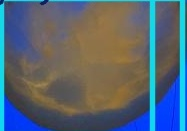


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2466_jpeg_jpg_4.jpg: 640x192 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 192)
Predictions for: IMG_2466_jpeg_jpg_4.jpg


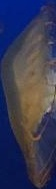


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_11.jpg: 448x640 (no detections), 12.8ms
Speed: 5.3ms preprocess, 12.8ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8595_MOV-0_jpg_11.jpg


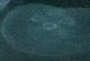


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_21.jpg: 480x640 1 person, 13.1ms
Speed: 3.5ms preprocess, 13.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8490_jpg_21.jpg


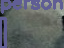


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_0.jpg: 640x416 (no detections), 13.0ms
Speed: 5.3ms preprocess, 13.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2574_jpeg_jpg_0.jpg


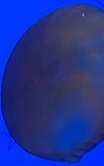


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_15.jpg: 384x640 (no detections), 11.6ms
Speed: 3.3ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8490_jpg_15.jpg


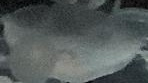


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8590_MOV-2_jpg_1.jpg: 640x384 1 vase, 14.2ms
Speed: 4.4ms preprocess, 14.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8590_MOV-2_jpg_1.jpg


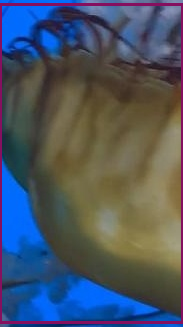


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_5.jpg: 448x640 (no detections), 12.7ms
Speed: 3.7ms preprocess, 12.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2574_jpeg_jpg_5.jpg


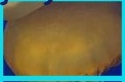


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_15.jpg: 512x640 (no detections), 27.5ms
Speed: 3.1ms preprocess, 27.5ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2470_jpeg_jpg_15.jpg


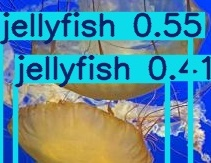


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2477_jpeg_jpg_0.jpg: 416x640 (no detections), 23.7ms
Speed: 10.5ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2477_jpeg_jpg_0.jpg


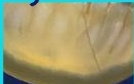


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_8.jpg: 224x640 (no detections), 33.8ms
Speed: 1.4ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2470_jpeg_jpg_8.jpg


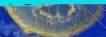


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_43.jpg: 416x640 (no detections), 14.0ms
Speed: 3.2ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8595_MOV-0_jpg_43.jpg


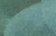


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_56.jpg: 480x640 (no detections), 16.6ms
Speed: 3.3ms preprocess, 16.6ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8490_jpg_56.jpg


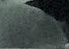


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_10.jpg: 640x448 (no detections), 13.8ms
Speed: 2.2ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8490_jpg_10.jpg


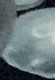


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_24.jpg: 512x640 (no detections), 14.2ms
Speed: 2.8ms preprocess, 14.2ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8490_jpg_24.jpg


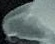


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_7.jpg: 640x544 (no detections), 17.0ms
Speed: 3.0ms preprocess, 17.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8595_MOV-0_jpg_7.jpg


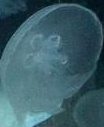


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_5.jpg: 640x608 (no detections), 17.1ms
Speed: 3.0ms preprocess, 17.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8490_jpg_5.jpg


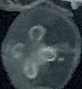


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_6.jpg: 640x608 (no detections), 16.2ms
Speed: 3.0ms preprocess, 16.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8490_jpg_6.jpg


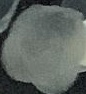


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_31.jpg: 480x640 (no detections), 14.2ms
Speed: 2.6ms preprocess, 14.2ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8490_jpg_31.jpg


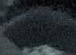


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8599_MOV-3_jpg_0.jpg: 640x544 (no detections), 15.7ms
Speed: 3.5ms preprocess, 15.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8599_MOV-3_jpg_0.jpg


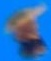


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_5.jpg: 448x640 (no detections), 11.4ms
Speed: 4.1ms preprocess, 11.4ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2470_jpeg_jpg_5.jpg


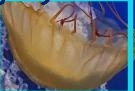


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_2.jpg: 640x448 (no detections), 10.5ms
Speed: 2.3ms preprocess, 10.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8490_jpg_2.jpg


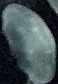


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_48.jpg: 384x640 (no detections), 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8490_jpg_48.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_14.jpg: 640x640 (no detections), 14.3ms
Speed: 5.5ms preprocess, 14.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2465_jpeg_jpg_14.jpg


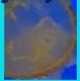


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_19.jpg: 640x640 (no detections), 13.2ms
Speed: 3.3ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_19.jpg


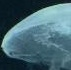


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_57.jpg: 576x640 (no detections), 13.7ms
Speed: 3.5ms preprocess, 13.7ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8490_jpg_57.jpg


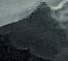


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_20.jpg: 448x640 (no detections), 11.5ms
Speed: 2.6ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8490_jpg_20.jpg


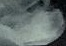


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_9.jpg: 384x640 (no detections), 9.6ms
Speed: 2.3ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2465_jpeg_jpg_9.jpg


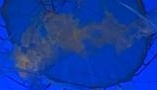


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_1.jpg: 576x640 (no detections), 12.3ms
Speed: 3.1ms preprocess, 12.3ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8595_MOV-0_jpg_1.jpg


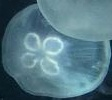


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_22.jpg: 448x640 (no detections), 12.6ms
Speed: 2.9ms preprocess, 12.6ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8595_MOV-0_jpg_22.jpg


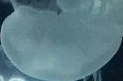


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_48.jpg: 640x512 (no detections), 9.7ms
Speed: 2.9ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_48.jpg


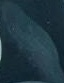


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_61.jpg: 640x320 (no detections), 10.0ms
Speed: 1.9ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_8595_MOV-0_jpg_61.jpg


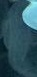


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_55.jpg: 576x640 (no detections), 16.3ms
Speed: 2.9ms preprocess, 16.3ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8595_MOV-0_jpg_55.jpg


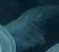


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_3.jpg: 480x640 1 cat, 14.0ms
Speed: 5.2ms preprocess, 14.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2465_jpeg_jpg_3.jpg


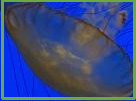


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_3.jpg: 416x640 (no detections), 11.8ms
Speed: 2.2ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2468_jpeg_jpg_3.jpg


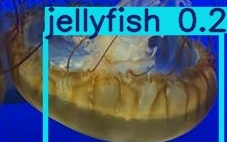


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_46.jpg: 352x640 (no detections), 9.1ms
Speed: 1.8ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8595_MOV-0_jpg_46.jpg


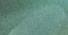


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_58.jpg: 640x512 (no detections), 11.0ms
Speed: 2.5ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_58.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_42.jpg: 640x640 (no detections), 12.4ms
Speed: 3.3ms preprocess, 12.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_42.jpg


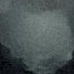


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_10.jpg: 448x640 (no detections), 9.9ms
Speed: 2.2ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2470_jpeg_jpg_10.jpg


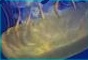


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_13.jpg: 640x640 (no detections), 12.2ms
Speed: 4.2ms preprocess, 12.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_13.jpg


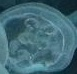


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_13.jpg: 640x608 (no detections), 12.2ms
Speed: 3.0ms preprocess, 12.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2470_jpeg_jpg_13.jpg


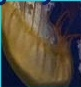


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_7.jpg: 640x640 1 cat, 12.2ms
Speed: 2.9ms preprocess, 12.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_7.jpg


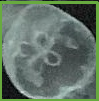


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_12.jpg: 320x640 (no detections), 9.7ms
Speed: 1.7ms preprocess, 9.7ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8490_jpg_12.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_54.jpg: 640x512 (no detections), 9.3ms
Speed: 2.6ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_54.jpg


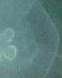


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_8.jpg: 416x640 (no detections), 9.8ms
Speed: 2.3ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2574_jpeg_jpg_8.jpg


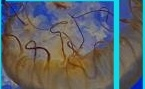


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_38.jpg: 608x640 (no detections), 11.8ms
Speed: 3.0ms preprocess, 11.8ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8490_jpg_38.jpg


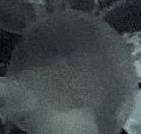


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2473_jpeg_jpg_1.jpg: 576x640 1 clock, 10.6ms
Speed: 3.0ms preprocess, 10.6ms inference, 2.8ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2473_jpeg_jpg_1.jpg


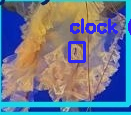


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_55.jpg: 640x384 (no detections), 9.1ms
Speed: 1.9ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8490_jpg_55.jpg


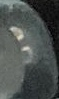


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_29.jpg: 640x384 (no detections), 8.3ms
Speed: 1.8ms preprocess, 8.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8595_MOV-0_jpg_29.jpg


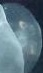


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_6.jpg: 640x416 (no detections), 9.3ms
Speed: 2.0ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2470_jpeg_jpg_6.jpg


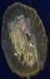


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_17.jpg: 416x640 (no detections), 8.8ms
Speed: 2.0ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8490_jpg_17.jpg


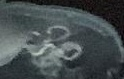


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_7.jpg: 640x384 (no detections), 9.1ms
Speed: 3.4ms preprocess, 9.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2470_jpeg_jpg_7.jpg


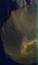


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_26.jpg: 640x512 (no detections), 9.0ms
Speed: 2.3ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8490_jpg_26.jpg


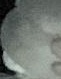


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_26.jpg: 640x480 (no detections), 9.4ms
Speed: 2.4ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8595_MOV-0_jpg_26.jpg


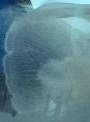


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_43.jpg: 640x384 (no detections), 10.0ms
Speed: 2.0ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8490_jpg_43.jpg


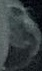


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_14.jpg: 224x640 (no detections), 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2470_jpeg_jpg_14.jpg


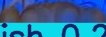


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_20.jpg: 640x640 (no detections), 10.7ms
Speed: 3.3ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_20.jpg


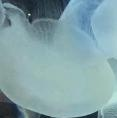


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_8.jpg: 160x640 (no detections), 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)
Predictions for: IMG_2468_jpeg_jpg_8.jpg


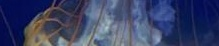


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_57.jpg: 480x640 (no detections), 9.4ms
Speed: 2.2ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8595_MOV-0_jpg_57.jpg


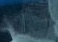


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_11.jpg: 640x512 (no detections), 9.1ms
Speed: 2.5ms preprocess, 9.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8490_jpg_11.jpg


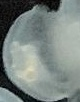


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_36.jpg: 640x480 (no detections), 9.6ms
Speed: 2.0ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8595_MOV-0_jpg_36.jpg


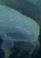


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_32.jpg: 640x416 (no detections), 11.2ms
Speed: 1.9ms preprocess, 11.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8490_jpg_32.jpg


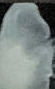


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_50.jpg: 640x512 (no detections), 9.2ms
Speed: 2.4ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8490_jpg_50.jpg


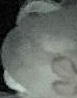


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_49.jpg: 576x640 (no detections), 10.3ms
Speed: 2.9ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8490_jpg_49.jpg


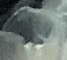


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_9.jpg: 416x640 (no detections), 9.3ms
Speed: 4.4ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2470_jpeg_jpg_9.jpg


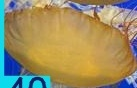


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_23.jpg: 640x640 (no detections), 10.7ms
Speed: 2.9ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_23.jpg


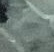


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_51.jpg: 640x640 (no detections), 9.8ms
Speed: 3.0ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_51.jpg


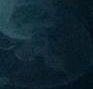


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_22.jpg: 640x640 (no detections), 9.8ms
Speed: 2.7ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_22.jpg


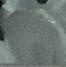


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_49.jpg: 640x416 (no detections), 8.8ms
Speed: 1.9ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8595_MOV-0_jpg_49.jpg


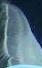


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_34.jpg: 416x640 (no detections), 8.9ms
Speed: 2.1ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8490_jpg_34.jpg


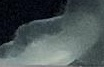


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8599_MOV-3_jpg_1.jpg: 640x576 (no detections), 10.4ms
Speed: 2.9ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8599_MOV-3_jpg_1.jpg


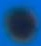


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_40.jpg: 608x640 (no detections), 10.4ms
Speed: 2.9ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8595_MOV-0_jpg_40.jpg


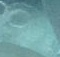


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2473_jpeg_jpg_2.jpg: 640x224 (no detections), 9.1ms
Speed: 1.3ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_2473_jpeg_jpg_2.jpg


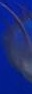


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_52.jpg: 640x576 (no detections), 10.4ms
Speed: 2.6ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8490_jpg_52.jpg


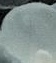


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_16.jpg: 448x640 (no detections), 9.6ms
Speed: 2.3ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2465_jpeg_jpg_16.jpg


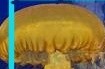


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_9.jpg: 640x480 (no detections), 9.4ms
Speed: 2.3ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8595_MOV-0_jpg_9.jpg


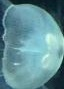


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_8.jpg: 608x640 (no detections), 10.5ms
Speed: 3.0ms preprocess, 10.5ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2465_jpeg_jpg_8.jpg


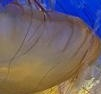


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_13.jpg: 384x640 (no detections), 13.6ms
Speed: 2.2ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2465_jpeg_jpg_13.jpg


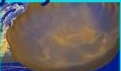


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_1.jpg: 512x640 1 vase, 10.2ms
Speed: 3.2ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2468_jpeg_jpg_1.jpg


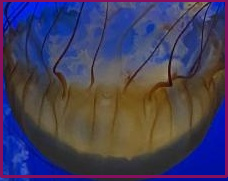


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_41.jpg: 576x640 1 cat, 9.9ms
Speed: 2.7ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8490_jpg_41.jpg


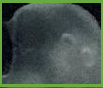


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_35.jpg: 640x640 (no detections), 11.6ms
Speed: 3.7ms preprocess, 11.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_35.jpg


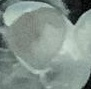


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8590_MOV-2_jpg_0.jpg: 640x608 (no detections), 9.4ms
Speed: 3.4ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8590_MOV-2_jpg_0.jpg


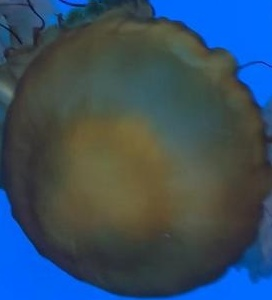


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_52.jpg: 640x640 (no detections), 11.6ms
Speed: 5.2ms preprocess, 11.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_52.jpg


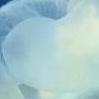


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_40.jpg: 640x512 (no detections), 12.6ms
Speed: 3.7ms preprocess, 12.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8490_jpg_40.jpg


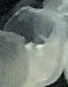


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2466_jpeg_jpg_1.jpg: 544x640 1 cake, 10.5ms
Speed: 2.6ms preprocess, 10.5ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2466_jpeg_jpg_1.jpg


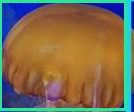


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_10.jpg: 512x640 (no detections), 9.3ms
Speed: 2.6ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2465_jpeg_jpg_10.jpg


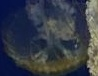


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_59.jpg: 640x416 (no detections), 9.4ms
Speed: 2.0ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8595_MOV-0_jpg_59.jpg


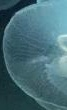


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_5.jpg: 640x640 (no detections), 11.5ms
Speed: 4.0ms preprocess, 11.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2465_jpeg_jpg_5.jpg


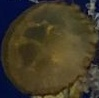


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_47.jpg: 640x608 (no detections), 11.8ms
Speed: 3.1ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8595_MOV-0_jpg_47.jpg


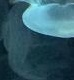


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_27.jpg: 320x640 (no detections), 9.2ms
Speed: 1.7ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8595_MOV-0_jpg_27.jpg


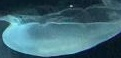


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_18.jpg: 448x640 (no detections), 12.2ms
Speed: 2.2ms preprocess, 12.2ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8595_MOV-0_jpg_18.jpg


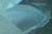


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_42.jpg: 640x224 (no detections), 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8595_MOV-0_jpg_42.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_46.jpg: 640x480 (no detections), 9.0ms
Speed: 2.2ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8490_jpg_46.jpg


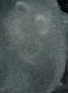


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_34.jpg: 544x640 (no detections), 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8595_MOV-0_jpg_34.jpg


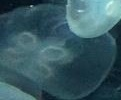


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_4.jpg: 544x640 1 cat, 8.2ms
Speed: 2.6ms preprocess, 8.2ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8595_MOV-0_jpg_4.jpg


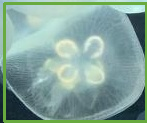


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_15.jpg: 640x416 (no detections), 8.3ms
Speed: 1.8ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_2465_jpeg_jpg_15.jpg


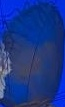


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_1.jpg: 640x640 1 vase, 9.6ms
Speed: 3.2ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2574_jpeg_jpg_1.jpg


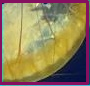


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_10.jpg: 640x448 (no detections), 9.1ms
Speed: 2.2ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8595_MOV-0_jpg_10.jpg


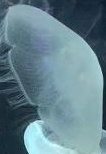


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_13.jpg: 576x640 (no detections), 9.2ms
Speed: 2.6ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8490_jpg_13.jpg


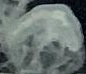


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_44.jpg: 544x640 1 cat, 9.3ms
Speed: 2.8ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_8595_MOV-0_jpg_44.jpg


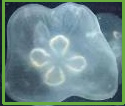


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_29.jpg: 640x640 (no detections), 9.6ms
Speed: 2.9ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_29.jpg


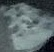


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_30.jpg: 512x640 (no detections), 8.8ms
Speed: 2.5ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8595_MOV-0_jpg_30.jpg


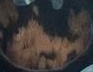


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2466_jpeg_jpg_2.jpg: 640x480 (no detections), 8.7ms
Speed: 2.1ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_2466_jpeg_jpg_2.jpg


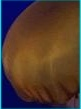


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_0.jpg: 640x608 (no detections), 9.8ms
Speed: 3.2ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2468_jpeg_jpg_0.jpg


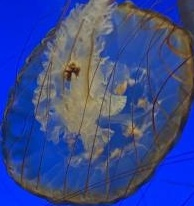


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_31.jpg: 640x512 1 cat, 9.5ms
Speed: 2.4ms preprocess, 9.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_31.jpg


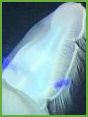


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_37.jpg: 256x640 (no detections), 9.1ms
Speed: 1.3ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_8490_jpg_37.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_17.jpg: 640x512 (no detections), 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8595_MOV-0_jpg_17.jpg


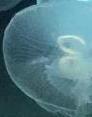


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_28.jpg: 480x640 (no detections), 9.7ms
Speed: 2.4ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_8595_MOV-0_jpg_28.jpg


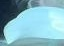


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_0.jpg: 576x640 (no detections), 10.2ms
Speed: 2.9ms preprocess, 10.2ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8595_MOV-0_jpg_0.jpg


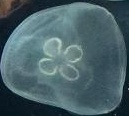


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_3.jpg: 640x384 (no detections), 10.6ms
Speed: 2.0ms preprocess, 10.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2470_jpeg_jpg_3.jpg


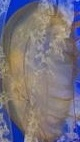


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_28.jpg: 640x576 (no detections), 10.0ms
Speed: 4.0ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8490_jpg_28.jpg


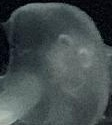


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_54.jpg: 640x608 (no detections), 9.4ms
Speed: 2.9ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_8490_jpg_54.jpg


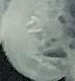


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_8.jpg: 352x640 (no detections), 9.2ms
Speed: 2.0ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_8595_MOV-0_jpg_8.jpg


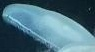


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_2.jpg: 640x576 1 bird, 9.3ms
Speed: 2.9ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_2470_jpeg_jpg_2.jpg


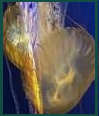


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_25.jpg: 640x480 (no detections), 9.1ms
Speed: 2.5ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_8490_jpg_25.jpg


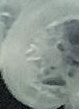


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_33.jpg: 640x576 (no detections), 9.2ms
Speed: 2.7ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8595_MOV-0_jpg_33.jpg


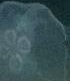


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_50.jpg: 416x640 (no detections), 9.5ms
Speed: 2.1ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8595_MOV-0_jpg_50.jpg


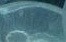


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_2.jpg: 416x640 (no detections), 8.7ms
Speed: 2.1ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8595_MOV-0_jpg_2.jpg


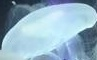


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2473_jpeg_jpg_0.jpg: 448x640 2 bowls, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2473_jpeg_jpg_0.jpg


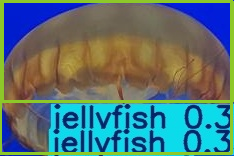


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_53.jpg: 448x640 (no detections), 8.7ms
Speed: 2.2ms preprocess, 8.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8595_MOV-0_jpg_53.jpg


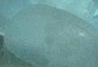


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_45.jpg: 640x640 (no detections), 9.6ms
Speed: 3.1ms preprocess, 9.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_45.jpg


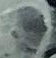


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_60.jpg: 384x640 (no detections), 9.2ms
Speed: 1.7ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_8595_MOV-0_jpg_60.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_56.jpg: 608x640 (no detections), 9.4ms
Speed: 3.0ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8595_MOV-0_jpg_56.jpg


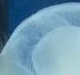


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_3.jpg: 576x640 (no detections), 9.2ms
Speed: 2.8ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2574_jpeg_jpg_3.jpg


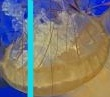


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2466_jpeg_jpg_0.jpg: 608x640 (no detections), 9.4ms
Speed: 2.8ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2466_jpeg_jpg_0.jpg


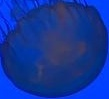


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_5.jpg: 640x256 (no detections), 13.6ms
Speed: 1.7ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_2468_jpeg_jpg_5.jpg


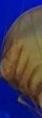


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_3.jpg: 640x640 (no detections), 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_3.jpg


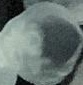


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_6.jpg: 640x384 (no detections), 11.1ms
Speed: 2.2ms preprocess, 11.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2468_jpeg_jpg_6.jpg


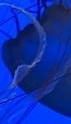


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_21.jpg: 416x640 1 cat, 9.7ms
Speed: 2.2ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8595_MOV-0_jpg_21.jpg


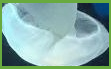


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8590_MOV-2_jpg_2.jpg: 640x448 (no detections), 9.5ms
Speed: 2.3ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_8590_MOV-2_jpg_2.jpg


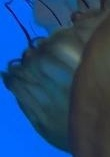


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_14.jpg: 640x576 1 cat, 9.7ms
Speed: 2.9ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8595_MOV-0_jpg_14.jpg


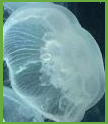


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_6.jpg: 416x640 (no detections), 9.3ms
Speed: 2.1ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_8595_MOV-0_jpg_6.jpg


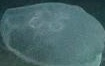


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_45.jpg: 640x544 (no detections), 9.4ms
Speed: 4.5ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8595_MOV-0_jpg_45.jpg


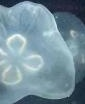


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_27.jpg: 512x640 (no detections), 12.9ms
Speed: 2.5ms preprocess, 12.9ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8490_jpg_27.jpg


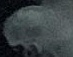


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_1.jpg: 544x640 1 vase, 11.1ms
Speed: 3.0ms preprocess, 11.1ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2465_jpeg_jpg_1.jpg


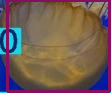


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_36.jpg: 288x640 (no detections), 11.8ms
Speed: 6.3ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_8490_jpg_36.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_4.jpg: 640x640 (no detections), 11.5ms
Speed: 3.6ms preprocess, 11.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8490_jpg_4.jpg


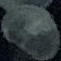


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2470_jpeg_jpg_12.jpg: 640x224 (no detections), 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_2470_jpeg_jpg_12.jpg


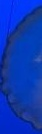


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_25.jpg: 640x640 (no detections), 9.5ms
Speed: 3.1ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8595_MOV-0_jpg_25.jpg


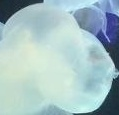


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_8.jpg: 448x640 1 cat, 9.6ms
Speed: 2.4ms preprocess, 9.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_8490_jpg_8.jpg


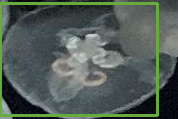


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_1.jpg: 640x544 (no detections), 9.2ms
Speed: 2.8ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8490_jpg_1.jpg


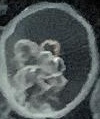


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2468_jpeg_jpg_4.jpg: 640x384 (no detections), 9.2ms
Speed: 2.1ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_2468_jpeg_jpg_4.jpg


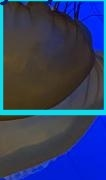


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8599_MOV-3_jpg_2.jpg: 640x320 (no detections), 9.5ms
Speed: 1.6ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_8599_MOV-3_jpg_2.jpg


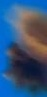


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_2.jpg: 640x544 (no detections), 9.4ms
Speed: 3.0ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_2574_jpeg_jpg_2.jpg


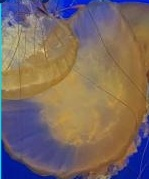


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2466_jpeg_jpg_3.jpg: 480x640 (no detections), 9.3ms
Speed: 2.5ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Predictions for: IMG_2466_jpeg_jpg_3.jpg


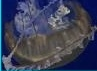


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8595_MOV-0_jpg_37.jpg: 640x384 (no detections), 9.2ms
Speed: 1.9ms preprocess, 9.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_8595_MOV-0_jpg_37.jpg


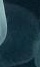


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2574_jpeg_jpg_4.jpg: 608x640 1 cat, 1 cow, 9.5ms
Speed: 3.1ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2574_jpeg_jpg_4.jpg


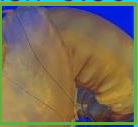


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_8490_jpg_53.jpg: 512x640 (no detections), 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_8490_jpg_53.jpg


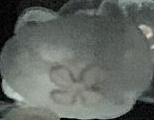


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/IMG_2465_jpeg_jpg_6.jpg: 640x576 (no detections), 11.7ms
Speed: 4.3ms preprocess, 11.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_2465_jpeg_jpg_6.jpg


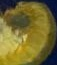

In [79]:
#Adding colours and confidence scores to it -- JELLYFISH
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/jellyfish/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3154_jpeg_jpg_0.jpg: 640x544 1 dog, 16.7ms
Speed: 2.4ms preprocess, 16.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3154_jpeg_jpg_0.jpg


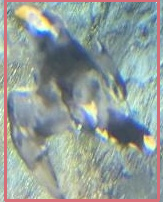


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_0.jpg: 640x640 (no detections), 18.4ms
Speed: 3.1ms preprocess, 18.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2526_jpeg_jpg_0.jpg


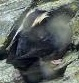


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_4.jpg: 640x608 (no detections), 16.9ms
Speed: 2.7ms preprocess, 16.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2526_jpeg_jpg_4.jpg


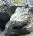


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3134_jpeg_jpg_0.jpg: 640x640 (no detections), 17.2ms
Speed: 3.1ms preprocess, 17.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_3134_jpeg_jpg_0.jpg


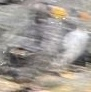


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_4.jpg: 640x352 (no detections), 12.4ms
Speed: 1.9ms preprocess, 12.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_3136_jpeg_jpg_4.jpg


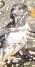


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_5.jpg: 608x640 (no detections), 16.9ms
Speed: 2.8ms preprocess, 16.9ms inference, 0.5ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_2526_jpeg_jpg_5.jpg


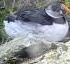


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_7.jpg: 640x512 (no detections), 10.1ms
Speed: 3.2ms preprocess, 10.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_3136_jpeg_jpg_7.jpg


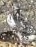


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_9.jpg: 640x448 (no detections), 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3136_jpeg_jpg_9.jpg


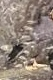


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3144_jpeg_jpg_2.jpg: 640x384 (no detections), 11.6ms
Speed: 2.0ms preprocess, 11.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3144_jpeg_jpg_2.jpg


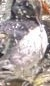


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_11.jpg: 640x416 (no detections), 10.1ms
Speed: 1.9ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_3136_jpeg_jpg_11.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3144_jpeg_jpg_0.jpg: 640x608 1 bear, 16.3ms
Speed: 3.8ms preprocess, 16.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_3144_jpeg_jpg_0.jpg


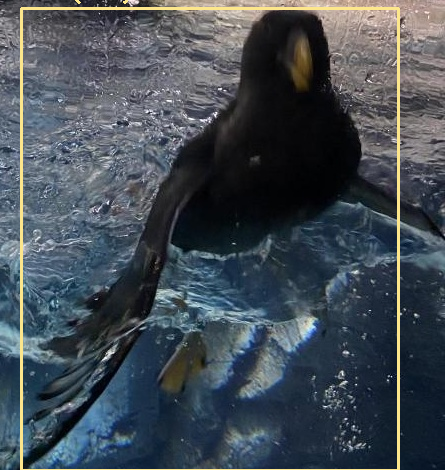


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3134_jpeg_jpg_3.jpg: 640x608 (no detections), 12.5ms
Speed: 3.2ms preprocess, 12.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_3134_jpeg_jpg_3.jpg


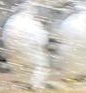


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_10.jpg: 640x448 (no detections), 14.4ms
Speed: 2.1ms preprocess, 14.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3136_jpeg_jpg_10.jpg


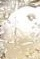


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_2.jpg: 640x320 (no detections), 9.0ms
Speed: 1.5ms preprocess, 9.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 320)
Predictions for: IMG_2526_jpeg_jpg_2.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_2.jpg: 640x544 (no detections), 13.2ms
Speed: 2.5ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3136_jpeg_jpg_2.jpg


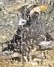


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_5.jpg: 640x384 (no detections), 9.1ms
Speed: 1.8ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Predictions for: IMG_3136_jpeg_jpg_5.jpg


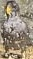


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_3.jpg: 640x480 (no detections), 10.4ms
Speed: 2.3ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Predictions for: IMG_3136_jpeg_jpg_3.jpg


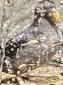


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_1.jpg: 288x640 (no detections), 9.1ms
Speed: 1.7ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_3136_jpeg_jpg_1.jpg


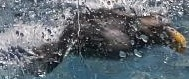


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_6.jpg: 640x448 (no detections), 10.0ms
Speed: 2.0ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3136_jpeg_jpg_6.jpg


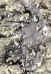


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3144_jpeg_jpg_3.jpg: 640x544 (no detections), 13.0ms
Speed: 2.7ms preprocess, 13.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_3144_jpeg_jpg_3.jpg


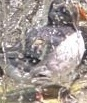


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_0.jpg: 640x352 (no detections), 9.2ms
Speed: 1.7ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 352)
Predictions for: IMG_3136_jpeg_jpg_0.jpg


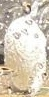


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_1.jpg: 544x640 (no detections), 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2526_jpeg_jpg_1.jpg


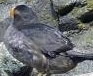


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3136_jpeg_jpg_8.jpg: 640x608 (no detections), 13.6ms
Speed: 3.1ms preprocess, 13.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_3136_jpeg_jpg_8.jpg


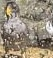


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_3144_jpeg_jpg_1.jpg: 640x448 (no detections), 9.1ms
Speed: 2.1ms preprocess, 9.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 448)
Predictions for: IMG_3144_jpeg_jpg_1.jpg


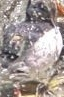


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/puffin/IMG_2526_jpeg_jpg_3.jpg: 448x640 (no detections), 9.3ms
Speed: 2.0ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2526_jpeg_jpg_3.jpg


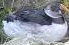

In [80]:
#Adding colours and confidence scores to it -- PUFFIN
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/puffin/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8396_jpg_0.jpg: 640x256 1 person, 10.6ms
Speed: 1.2ms preprocess, 10.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_8396_jpg_0.jpg


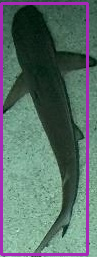


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8420_jpg_9.jpg: 576x640 (no detections), 17.4ms
Speed: 2.7ms preprocess, 17.4ms inference, 0.5ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_8420_jpg_9.jpg


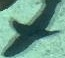


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2496_jpeg_jpg_1.jpg: 448x640 (no detections), 13.8ms
Speed: 3.5ms preprocess, 13.8ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2496_jpeg_jpg_1.jpg


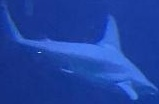


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2514_jpeg_jpg_1.jpg: 352x640 1 car, 11.6ms
Speed: 2.1ms preprocess, 11.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2514_jpeg_jpg_1.jpg


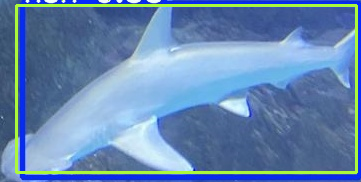


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_7.jpg: 608x640 (no detections), 16.9ms
Speed: 2.9ms preprocess, 16.9ms inference, 0.5ms postprocess per image at shape (1, 3, 608, 640)
Predictions for: IMG_8395_jpg_7.jpg


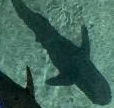


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8404_jpg_12.jpg: 640x128 (no detections), 50.3ms
Speed: 1.0ms preprocess, 50.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 128)
Predictions for: IMG_8404_jpg_12.jpg


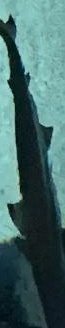


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_11.jpg: 640x640 (no detections), 16.5ms
Speed: 3.0ms preprocess, 16.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_8395_jpg_11.jpg


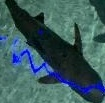


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_2.jpg: 640x256 1 banana, 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 256)
Predictions for: IMG_8395_jpg_2.jpg


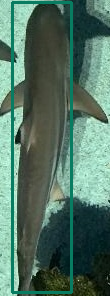


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2582_jpeg_jpg_2.jpg: 640x640 (no detections), 16.4ms
Speed: 4.1ms preprocess, 16.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2582_jpeg_jpg_2.jpg


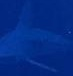


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2423_jpeg_jpg_0.jpg: 416x640 (no detections), 13.7ms
Speed: 2.4ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2423_jpeg_jpg_0.jpg


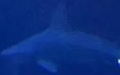


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_1.jpg: 640x224 (no detections), 11.9ms
Speed: 1.4ms preprocess, 11.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8395_jpg_1.jpg


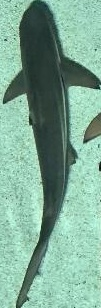


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2448_jpeg_jpg_10.jpg: 224x640 (no detections), 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)
Predictions for: IMG_2448_jpeg_jpg_10.jpg


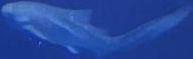


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2570_jpeg_jpg_7.jpg: 256x640 (no detections), 10.0ms
Speed: 1.9ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2570_jpeg_jpg_7.jpg


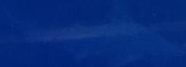


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2582_jpeg_jpg_1.jpg: 192x640 (no detections), 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 640)
Predictions for: IMG_2582_jpeg_jpg_1.jpg


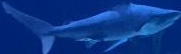


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2582_jpeg_jpg_10.jpg: 416x640 (no detections), 13.2ms
Speed: 2.2ms preprocess, 13.2ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2582_jpeg_jpg_10.jpg


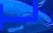


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2446_jpeg_jpg_0.jpg: 256x640 (no detections), 9.7ms
Speed: 2.0ms preprocess, 9.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2446_jpeg_jpg_0.jpg


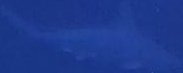


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8396_jpg_1.jpg: 640x224 (no detections), 11.8ms
Speed: 1.4ms preprocess, 11.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8396_jpg_1.jpg


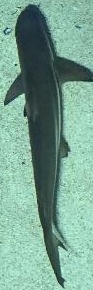


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2448_jpeg_jpg_0.jpg: 288x640 (no detections), 10.7ms
Speed: 1.9ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2448_jpeg_jpg_0.jpg


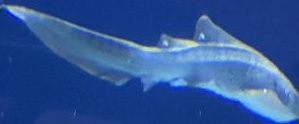


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2448_jpeg_jpg_8.jpg: 576x640 (no detections), 16.0ms
Speed: 3.0ms preprocess, 16.0ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)
Predictions for: IMG_2448_jpeg_jpg_8.jpg


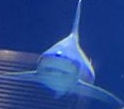


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_0.jpg: 640x288 (no detections), 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 288)
Predictions for: IMG_8395_jpg_0.jpg


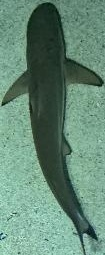


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2514_jpeg_jpg_0.jpg: 352x640 (no detections), 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2514_jpeg_jpg_0.jpg


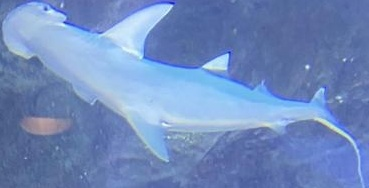


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2570_jpeg_jpg_3.jpg: 288x640 (no detections), 10.4ms
Speed: 1.7ms preprocess, 10.4ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2570_jpeg_jpg_3.jpg


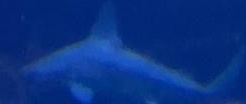


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8396_jpg_4.jpg: 640x544 1 dog, 15.4ms
Speed: 3.1ms preprocess, 15.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8396_jpg_4.jpg


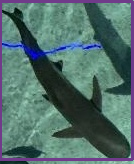


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2570_jpeg_jpg_0.jpg: 416x640 1 airplane, 12.8ms
Speed: 2.6ms preprocess, 12.8ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2570_jpeg_jpg_0.jpg


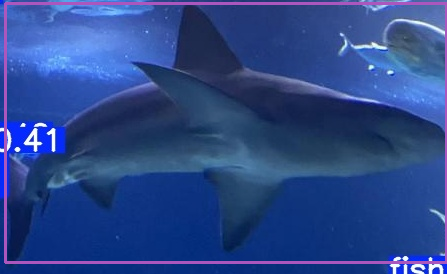


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2423_jpeg_jpg_3.jpg: 288x640 (no detections), 11.0ms
Speed: 1.9ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2423_jpeg_jpg_3.jpg


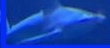


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2499_jpeg_jpg_0.jpg: 384x640 3 persons, 10.7ms
Speed: 2.8ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Predictions for: IMG_2499_jpeg_jpg_0.jpg


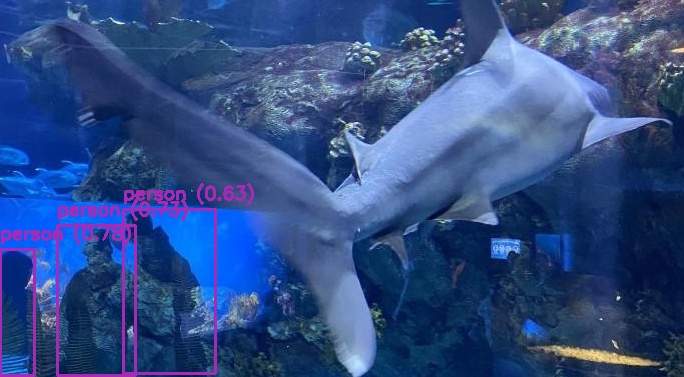


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8420_jpg_0.jpg: 640x416 (no detections), 17.0ms
Speed: 2.6ms preprocess, 17.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)
Predictions for: IMG_8420_jpg_0.jpg


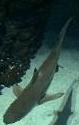


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8396_jpg_2.jpg: 640x224 (no detections), 12.0ms
Speed: 4.0ms preprocess, 12.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 224)
Predictions for: IMG_8396_jpg_2.jpg


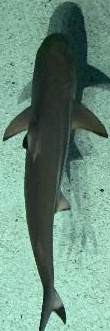


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2496_jpeg_jpg_3.jpg: 512x640 (no detections), 15.1ms
Speed: 3.9ms preprocess, 15.1ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2496_jpeg_jpg_3.jpg


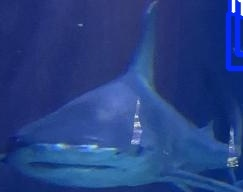


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_3.jpg: 640x576 (no detections), 16.9ms
Speed: 5.0ms preprocess, 16.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_8395_jpg_3.jpg


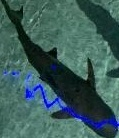


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8420_jpg_10.jpg: 640x512 (no detections), 12.0ms
Speed: 2.5ms preprocess, 12.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 512)
Predictions for: IMG_8420_jpg_10.jpg


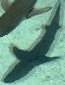


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_12.jpg: 640x288 (no detections), 10.3ms
Speed: 1.7ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 288)
Predictions for: IMG_8395_jpg_12.jpg


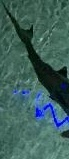


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2450_jpeg_jpg_1.jpg: 352x640 1 bed, 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2450_jpeg_jpg_1.jpg


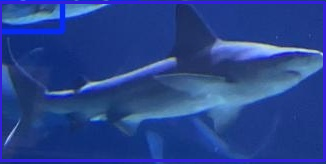


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_8395_jpg_10.jpg: 640x544 (no detections), 15.4ms
Speed: 2.7ms preprocess, 15.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 544)
Predictions for: IMG_8395_jpg_10.jpg


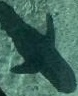


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2582_jpeg_jpg_7.jpg: 320x640 (no detections), 10.6ms
Speed: 1.5ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2582_jpeg_jpg_7.jpg



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2496_jpeg_jpg_2.jpg: 416x640 (no detections), 12.6ms
Speed: 2.1ms preprocess, 12.6ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)
Predictions for: IMG_2496_jpeg_jpg_2.jpg


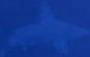


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2434_jpeg_jpg_3.jpg: 640x640 (no detections), 15.8ms
Speed: 4.5ms preprocess, 15.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2434_jpeg_jpg_3.jpg


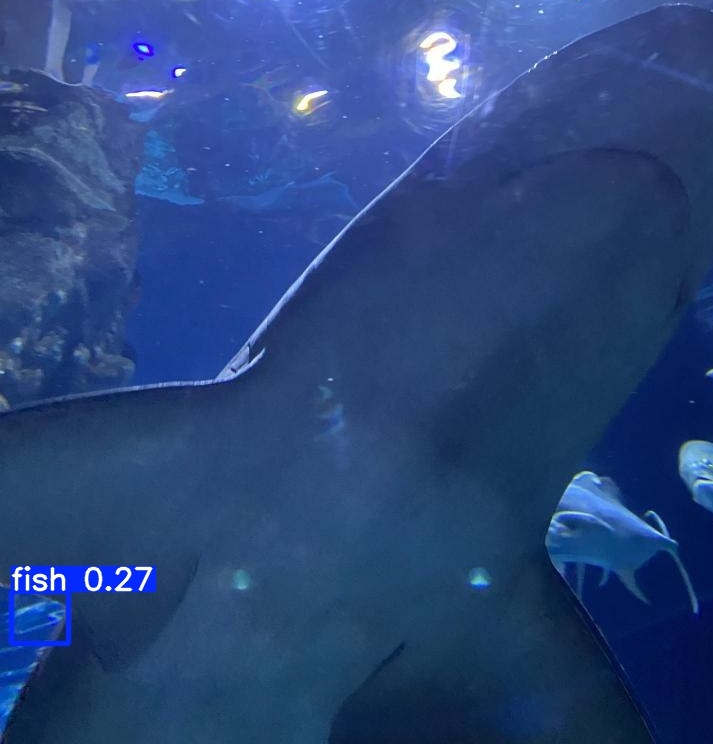


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/shark/IMG_2446_jpeg_jpg_2.jpg: 288x640 (no detections), 14.6ms
Speed: 1.8ms preprocess, 14.6ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2446_jpeg_jpg_2.jpg


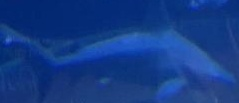

In [81]:
#Adding colours and confidence scores to it -- SHARK
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/shark/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2544_jpeg_jpg_0.jpg: 640x576 1 person, 1 elephant, 16.7ms
Speed: 2.1ms preprocess, 16.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)
Predictions for: IMG_2544_jpeg_jpg_0.jpg


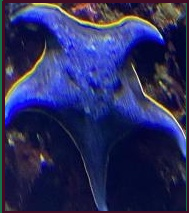


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2379_jpeg_jpg_2.jpg: 640x608 1 person, 16.9ms
Speed: 3.5ms preprocess, 16.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2379_jpeg_jpg_2.jpg


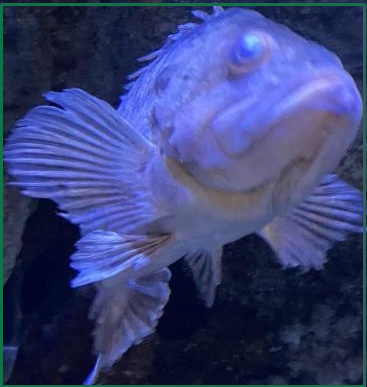


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2544_jpeg_jpg_1.jpg: 512x640 (no detections), 14.1ms
Speed: 6.4ms preprocess, 14.1ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2544_jpeg_jpg_1.jpg


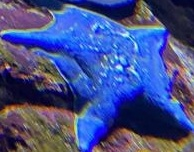


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2387_jpeg_jpg_0.jpg: 640x608 1 snowboard, 1 teddy bear, 1 toothbrush, 17.6ms
Speed: 3.9ms preprocess, 17.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 608)
Predictions for: IMG_2387_jpeg_jpg_0.jpg


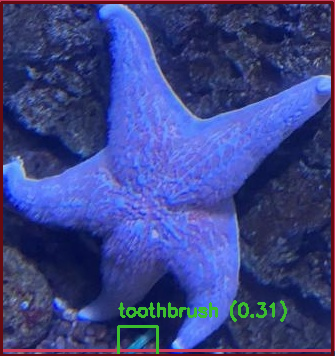


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2544_jpeg_jpg_2.jpg: 544x640 (no detections), 16.9ms
Speed: 3.1ms preprocess, 16.9ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)
Predictions for: IMG_2544_jpeg_jpg_2.jpg


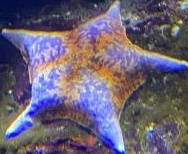


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2532_jpeg_jpg_0.jpg: 640x640 (no detections), 17.4ms
Speed: 3.1ms preprocess, 17.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predictions for: IMG_2532_jpeg_jpg_0.jpg


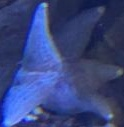


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2547_jpeg_jpg_0.jpg: 448x640 (no detections), 14.3ms
Speed: 2.5ms preprocess, 14.3ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2547_jpeg_jpg_0.jpg


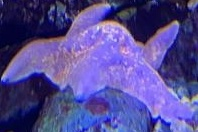


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/starfish/IMG_2532_jpeg_jpg_1.jpg: 512x640 (no detections), 14.1ms
Speed: 2.8ms preprocess, 14.1ms inference, 3.0ms postprocess per image at shape (1, 3, 512, 640)
Predictions for: IMG_2532_jpeg_jpg_1.jpg


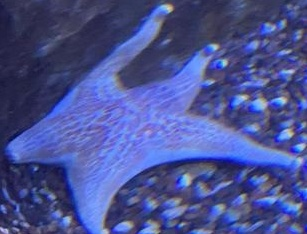

In [82]:
#Adding colours and confidence scores to it -- STARFISH
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/starfish/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)



image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2632_jpeg_jpg_4.jpg: 448x640 (no detections), 26.1ms
Speed: 4.6ms preprocess, 26.1ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Predictions for: IMG_2632_jpeg_jpg_4.jpg


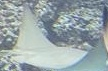


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2588_jpeg_jpg_0.jpg: 352x640 1 dog, 14.5ms
Speed: 4.3ms preprocess, 14.5ms inference, 6.4ms postprocess per image at shape (1, 3, 352, 640)
Predictions for: IMG_2588_jpeg_jpg_0.jpg


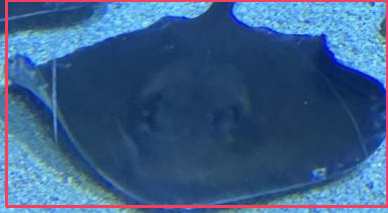


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_8404_jpg_3.jpg: 640x160 (no detections), 104.1ms
Speed: 1.2ms preprocess, 104.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 160)
Predictions for: IMG_8404_jpg_3.jpg


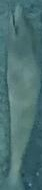


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_8404_jpg_1.jpg: 640x288 1 person, 25.4ms
Speed: 1.9ms preprocess, 25.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 288)
Predictions for: IMG_8404_jpg_1.jpg


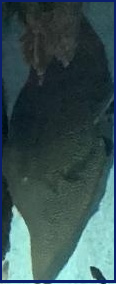


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2632_jpeg_jpg_6.jpg: 320x640 (no detections), 21.4ms
Speed: 3.3ms preprocess, 21.4ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2632_jpeg_jpg_6.jpg


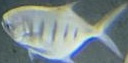


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2651_jpeg_jpg_0.jpg: 256x640 (no detections), 15.5ms
Speed: 1.7ms preprocess, 15.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2651_jpeg_jpg_0.jpg


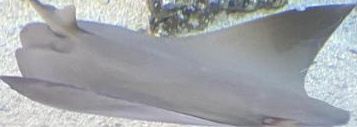


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2632_jpeg_jpg_0.jpg: 320x640 1 bird, 22.2ms
Speed: 5.1ms preprocess, 22.2ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2632_jpeg_jpg_0.jpg


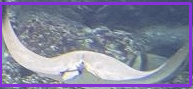


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2588_jpeg_jpg_1.jpg: 288x640 (no detections), 20.0ms
Speed: 3.9ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2588_jpeg_jpg_1.jpg


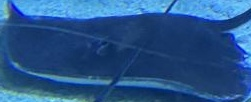


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2630_jpeg_jpg_0.jpg: 320x640 1 bird, 1 surfboard, 23.9ms
Speed: 2.0ms preprocess, 23.9ms inference, 3.5ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2630_jpeg_jpg_0.jpg


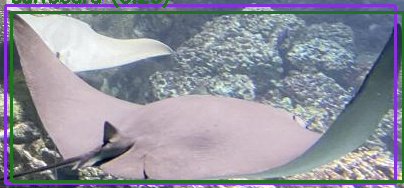


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_8590_MOV-5_jpg_0.jpg: 320x640 (no detections), 27.5ms
Speed: 3.6ms preprocess, 27.5ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_8590_MOV-5_jpg_0.jpg


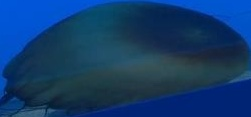


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2496_jpeg_jpg_4.jpg: 160x640 (no detections), 31.5ms
Speed: 1.2ms preprocess, 31.5ms inference, 4.2ms postprocess per image at shape (1, 3, 160, 640)
Predictions for: IMG_2496_jpeg_jpg_4.jpg


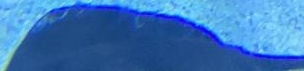


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2588_jpeg_jpg_2.jpg: 288x640 1 bird, 21.8ms
Speed: 2.1ms preprocess, 21.8ms inference, 1.8ms postprocess per image at shape (1, 3, 288, 640)
Predictions for: IMG_2588_jpeg_jpg_2.jpg


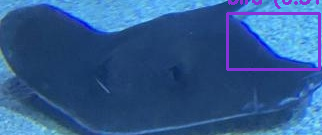


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2582_jpeg_jpg_0.jpg: 256x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 640)
Predictions for: IMG_2582_jpeg_jpg_0.jpg


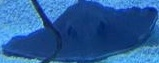


image 1/1 /content/AquariumYOLO/yolov8n-preds/crops/train/stingray/IMG_2582_jpeg_jpg_4.jpg: 320x640 (no detections), 27.8ms
Speed: 1.7ms preprocess, 27.8ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)
Predictions for: IMG_2582_jpeg_jpg_4.jpg


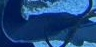

In [83]:
#Adding colours and confidence scores to it -- STINGRAY
import os
import cv2
import random
from ultralytics import YOLO
from PIL import Image
from google.colab.patches import cv2_imshow

# Load YOLOv8 model
yolo_model = YOLO("yolov8s.pt")

# Path to folder with cropped images
folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/stingray/"

# Get all image files
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Create a color for each class
class_colors = {}

for file_name in image_files:
    image_path = os.path.join(folder_path, file_name)

    # Run inference
    results = yolo_model(image_path)[0]

    # Load image with OpenCV
    img_cv = cv2.imread(image_path)

    # Draw bounding boxes, class labels, and confidence
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])
        label = results.names[class_id]

        # Assign rando colour
        if label not in class_colors:
            class_colors[label] = [random.randint(0, 255) for _ in range(3)]

        color = class_colors[label]

        # Draw box and label
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), color, 2)
        label_text = f"{label} ({confidence:.2f})"
        cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, color, 2)

    print(f"Predictions for: {file_name}")
    cv2_imshow(img_cv)

    output_path = os.path.join(folder_path, "pred_" + file_name)
    cv2.imwrite(output_path, img_cv)


In [91]:
# MemoryError
import torchvision.transforms as transforms
from torchcam.methods import SmoothGradCAMpp
from torchvision.transforms.functional import to_pil_image
from google.colab.patches import cv2_imshow
from ultralytics import YOLO

yolo_model = YOLO("yolov8s-cls.pt")

import torch.nn as nn

import torch.nn as nn

class JustLogits(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model

    def forward(self, x):
        output = self.model(x)
        # Return only logits
        return output[0] if isinstance(output, (tuple, list)) else output


wrapped_model = LogitsOnlyModel(yolo_model)

# Set up CAM extractor
cam_extractor = SmoothGradCAMpp(wrapped_model)

# Define preprocessing transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

image_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin/IMG_2301_jpeg_jpg_0.jpg"
img_pil = Image.open(image_path).convert("RGB")
input_tensor = transform(img_pil).unsqueeze(0)

# Run prediction
output = wrapped_model(input_tensor)
predicted_class = output.argmax(dim=1).item()

# Extract activation map
activation_map = cam_extractor(predicted_class, output)

# Overlay CAM on image
grayscale_cam = activation_map[0].squeeze().cpu().numpy()
grayscale_cam = cv2.resize(grayscale_cam, (224, 224))
heatmap = cv2.applyColorMap(np.uint8(255 * grayscale_cam), cv2.COLORMAP_JET)
heatmap = np.float32(heatmap) / 255

img_np = np.array(img_pil.resize((224, 224))) / 255.0
cam_result = heatmap + img_np
cam_result = cam_result / cam_result.max()

output_image = np.uint8(255 * cam_result)
cv2_imshow(output_image)
cv2.imwrite("explained_output.jpg", output_image)


AttributeError: 'tuple' object has no attribute 'shape'

In [92]:
#Alternative
!pip install grad-cam --quiet


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 59.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [97]:
from ultralytics import YOLO
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image, preprocess_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from torchvision import transforms
from PIL import Image
import numpy as np
import torch
import matplotlib.pyplot as plt


In [98]:
from glob import glob

folder_path = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin/"
image_paths = glob(os.path.join(folder_path, "*.jpg"))

for image_path in image_paths:
    img_pil = Image.open(image_path).convert("RGB")

    transform = transforms.Compose([
        transforms.Resize((224, 224)),
    ])

    resized_image = transform(img_pil)
    img_np = np.array(resized_image) / 255.0
    img_np = np.float32(img_np)

    input_tensor = preprocess_image(
        img_np, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

    output = classifier_model(input_tensor)
    predicted_class = output.argmax().item()

    # Run CAM
    grayscale_cam = cam(input_tensor=input_tensor, targets=[ClassifierOutputTarget(predicted_class)])
    grayscale_cam = grayscale_cam[0]

    # Overlay CAM
    visualization = show_cam_on_image(img_np, grayscale_cam, use_rgb=True)

    plt.imshow(visualization)
    plt.axis('off')
    plt.title(f"{os.path.basename(image_path)} | Class: {predicted_class}")
    plt.show()



AttributeError: 'tuple' object has no attribute 'shape'

In [102]:
input_tensor.requires_grad_()


tensor([[[[0.9988, 0.9988, 0.9988,  ..., 1.3242, 1.3242, 1.3242],
          [0.9988, 0.9988, 0.9988,  ..., 1.3242, 1.3242, 1.3242],
          [0.9988, 0.9988, 0.9988,  ..., 1.3242, 1.3242, 1.3242],
          ...,
          [1.3242, 1.3242, 1.3242,  ..., 0.5707, 0.5707, 0.5707],
          [1.3242, 1.3242, 1.3242,  ..., 0.5707, 0.5707, 0.5707],
          [1.3242, 1.3242, 1.3242,  ..., 0.5707, 0.5707, 0.5707]],

         [[0.8354, 0.8354, 0.8354,  ..., 1.2381, 1.2381, 1.2381],
          [0.8354, 0.8354, 0.8354,  ..., 1.2381, 1.2381, 1.2381],
          [0.8354, 0.8354, 0.8354,  ..., 1.2381, 1.2381, 1.2381],
          ...,
          [1.3256, 1.3256, 1.3256,  ..., 0.5553, 0.5553, 0.5553],
          [1.3256, 1.3256, 1.3256,  ..., 0.5553, 0.5553, 0.5553],
          [1.3256, 1.3256, 1.3256,  ..., 0.5553, 0.5553, 0.5553]],

         [[0.8448, 0.8448, 0.8448,  ..., 1.2282, 1.2282, 1.2282],
          [0.8448, 0.8448, 0.8448,  ..., 1.2282, 1.2282, 1.2282],
          [0.8448, 0.8448, 0.8448,  ..., 1

In [105]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image, preprocess_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from ultralytics import YOLO

yolo_model = YOLO("yolov8s-cls.pt")
classifier_model = yolo_model.model.eval()

class WrappedModel(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model

    def forward(self, x):
        output = self.model(x)
        if isinstance(output, tuple):
            return output[0]
        return output

wrapped_classifier = WrappedModel(classifier_model)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
wrapped_classifier.to(device)

target_layers = [wrapped_classifier.model.model[-1]]

def reshape_transform(tensor):
    if isinstance(tensor, tuple):
        tensor = tensor[0]
    return tensor

cam = GradCAM(model=wrapped_classifier, target_layers=target_layers, reshape_transform=reshape_transform)

image_folder = "/content/AquariumYOLO/yolov8n-preds/crops/train/penguin"
image_paths = [os.path.join(image_folder, fname) for fname in os.listdir(image_folder) if fname.endswith((".jpg", ".png", ".jpeg"))]

for image_path in image_paths:
    img_pil = Image.open(image_path).convert("RGB")
    transform = transforms.Resize((224, 224))
    resized_image = transform(img_pil)

    img_np = np.array(resized_image) / 255.0
    img_np = np.float32(img_np)

    input_tensor = preprocess_image(
        img_np, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
    ).to(device)
    input_tensor.requires_grad_()

    output = wrapped_classifier(input_tensor)
    predicted_class = output.argmax().item()

    grayscale_cam = cam(input_tensor=input_tensor, targets=[ClassifierOutputTarget(predicted_class)])
    grayscale_cam = grayscale_cam[0]

    visualization = show_cam_on_image(img_np, grayscale_cam, use_rgb=True)

    plt.imshow(visualization)
    plt.axis('off')
    plt.title(f"{os.path.basename(image_path)} | Class: {predicted_class}")
    plt.show()


AttributeError: 'NoneType' object has no attribute 'shape'

In [113]:
from ultralytics import YOLO

model = YOLO("/content/AquariumYOLO/yolov8n-custom/weights/best.pt")

results = model.val(data="/content/drive/MyDrive/archive/aquarium_pretrain/data.yaml")

precision = results.box.mp
recall = results.box.mr
map50 = results.box.map50
map5095 = results.box.map

print("Validation Metrics:")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"mAP@0.5: {map50:.4f}")
print(f"mAP@0.5:0.95: {map5095:.4f}")




Ultralytics 8.3.104 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,128,293 parameters, 0 gradients, 28.5 GFLOPs


val: Scanning /content/drive/MyDrive/archive/aquarium_pretrain/valid/labels.cache... 127 images, 0 backgrounds, 0 corrupt: 100%|██████████| 127/127 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]


                   all        127        909      0.794      0.696       0.76      0.476
                  fish         63        459      0.825      0.745      0.829      0.489
             jellyfish          9        155      0.813      0.884       0.91      0.529
               penguin         17        104      0.706      0.692      0.755      0.348
                puffin         15         74        0.7      0.504      0.588       0.32
                 shark         28         57      0.797      0.596      0.665      0.464
              starfish         17         27      0.936      0.704      0.805      0.619
              stingray         23         33      0.779      0.749      0.768      0.564
Speed: 4.8ms preprocess, 7.7ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to runs/detect/val5
Validation Metrics:
Precision: 0.7936
Recall: 0.6963
mAP@0.5: 0.7598
mAP@0.5:0.95: 0.4760


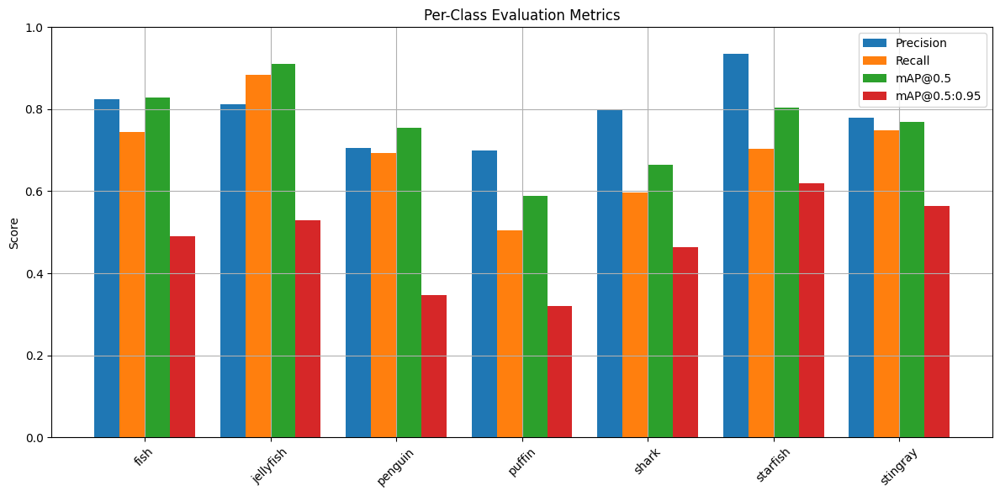

In [114]:
import matplotlib.pyplot as plt
import numpy as np

class_names = ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']

precision_per_class = results.box.p
recall_per_class = results.box.r
map50_per_class = results.box.ap50
map5095_per_class = results.box.ap

x = np.arange(len(class_names))
width = 0.2

plt.figure(figsize=(12, 6))
plt.bar(x - 1.5*width, precision_per_class, width, label='Precision')
plt.bar(x - 0.5*width, recall_per_class, width, label='Recall')
plt.bar(x + 0.5*width, map50_per_class, width, label='mAP@0.5')
plt.bar(x + 1.5*width, map5095_per_class, width, label='mAP@0.5:0.95')

plt.xticks(x, class_names, rotation=45)
plt.ylabel("Score")
plt.title("Per-Class Evaluation Metrics")
plt.ylim(0, 1)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [115]:
import pandas as pd

# Data for CSV
metrics_df = pd.DataFrame({
    "Class": class_names,
    "Precision": precision_per_class,
    "Recall": recall_per_class,
    "mAP@0.5": map50_per_class,
    "mAP@0.5:0.95": map5095_per_class
})

csv_path = "/content/yolo_val_metrics.csv"
metrics_df.to_csv(csv_path, index=False)

print(f" Metrics saved to {csv_path}")


 Metrics saved to /content/yolo_val_metrics.csv


In [116]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Get predictions and ground truths from results
pred = results.results
true_labels = []
pred_labels = []

for r in pred:
    true_labels.extend(r['labels'].cpu().numpy())
    pred_labels.extend(r['boxes'].cls.cpu().numpy())

# Create confusion matrix
cm = confusion_matrix(true_labels, pred_labels, labels=list(range(len(class_names))))

# Plot
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', xticklabels=class_names, yticklabels=class_names, cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()


AttributeError: 'DetMetrics' object has no attribute 'results'. See valid attributes below.

    Utility class for computing detection metrics such as precision, recall, and mean average precision (mAP).

    Attributes:
        save_dir (Path): A path to the directory where the output plots will be saved.
        plot (bool): A flag that indicates whether to plot precision-recall curves for each class.
        names (dict): A dictionary of class names.
        box (Metric): An instance of the Metric class for storing detection results.
        speed (dict): A dictionary for storing execution times of different parts of the detection process.
        task (str): The task type, set to 'detect'.
    


image 1/1 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg: 640x480 5 penguins, 27.9ms
Speed: 5.9ms preprocess, 27.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/detect/predict


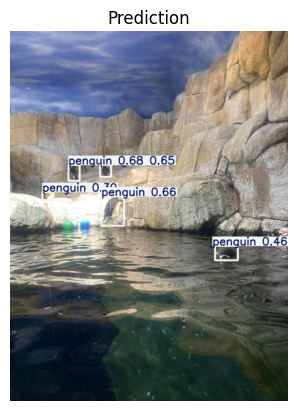

In [118]:
from ultralytics import YOLO
from PIL import Image
import matplotlib.pyplot as plt
import os

model = YOLO("/content/AquariumYOLO/yolov8n-custom/weights/best.pt")

results = model("/content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg", conf=0.25, save=True)

predicted_image_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))

img = Image.open(predicted_image_path)
plt.imshow(img)
plt.axis('off')
plt.title("Prediction")
plt.show()




image 1/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg: 640x480 1 penguin, 13.5ms
image 2/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg: 640x480 23 penguins, 12.8ms
image 3/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg: 640x480 10 penguins, 12.8ms
image 4/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg: 640x480 3 penguins, 13.4ms
image 5/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg: 640x480 5 penguins, 15.5ms
image 6/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg: 640x480 3 fishs, 18.7ms
image 7/63 /content/drive/MyDrive/archive/aquarium_pr

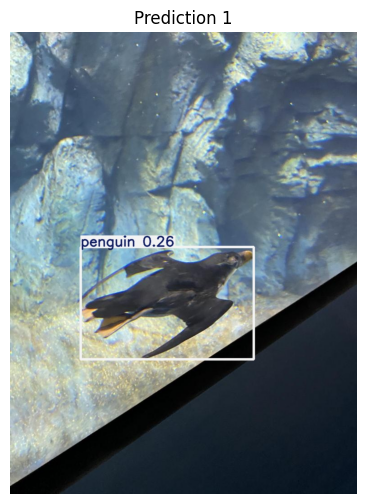

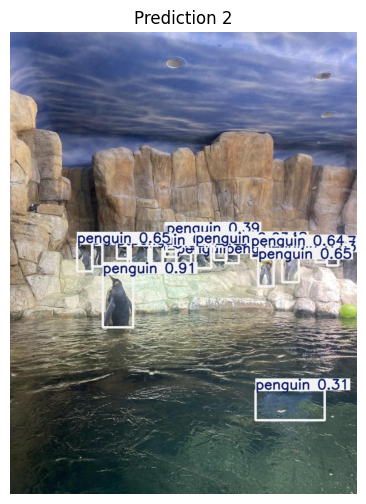

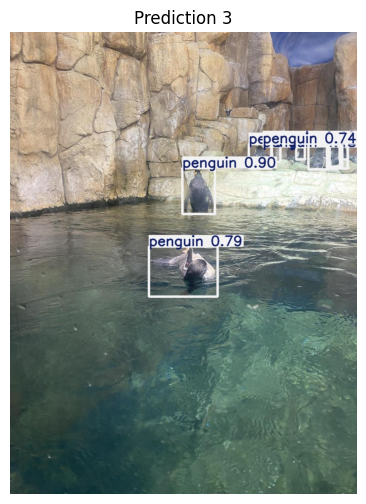

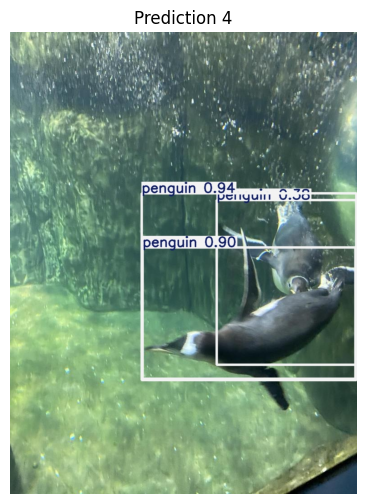

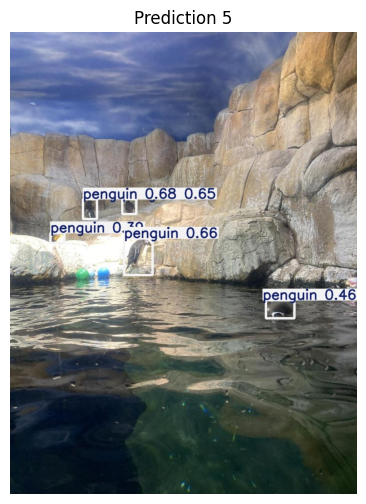

In [119]:
#For all
from ultralytics import YOLO
import os
from PIL import Image
import matplotlib.pyplot as plt

model = YOLO("/content/AquariumYOLO/yolov8n-custom/weights/best.pt")

test_folder = "/content/drive/MyDrive/archive/aquarium_pretrain/test/images"

results = model(test_folder, conf=0.25, save=True)

for i, res in enumerate(results):
    if i >= 5:
        break

    img_path = os.path.join(res.save_dir, os.path.basename(res.path))
    img = Image.open(img_path)

    plt.figure(figsize=(8, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Prediction {i+1}")
    plt.show()


In [120]:
import shutil

shutil.move("runs/detect/predict", "/content/drive/MyDrive/predictions_yolo")


'/content/drive/MyDrive/predictions_yolo'

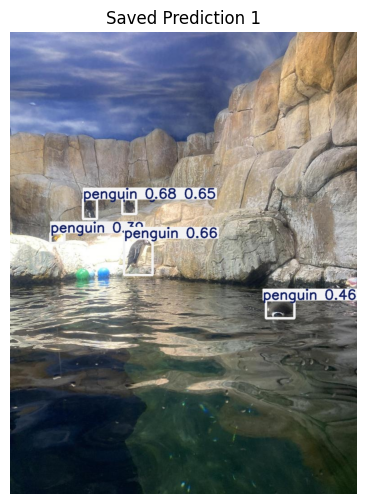

In [121]:
from PIL import Image
import matplotlib.pyplot as plt
import os

saved_folder = "/content/drive/MyDrive/predictions_yolo"

for i, filename in enumerate(os.listdir(saved_folder)):
    if not filename.endswith((".jpg", ".png")):
        continue
    if i >= 5:
        break
    img_path = os.path.join(saved_folder, filename)
    img = Image.open(img_path)

    plt.figure(figsize=(8, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Saved Prediction {i+1}")
    plt.show()


In [124]:
#To save predictions in drive
from ultralytics import YOLO
import shutil
import os

model = YOLO("/content/AquariumYOLO/yolov8n-custom/weights/best.pt")

results = model.predict(
    source="/content/drive/MyDrive/archive/aquarium_pretrain/test/images",
    save=True,
    conf=0.25,
    imgsz=640
)

output_path = "runs/detect/predict"
drive_path = "/content/drive/MyDrive/predictions_yolo"

if os.path.exists(output_path):
    shutil.move(output_path, drive_path)
    print(f"Predictions saved to: {drive_path}")
else:
    print("No prediction folder found!")



image 1/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg: 640x480 1 penguin, 16.8ms
image 2/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg: 640x480 23 penguins, 12.2ms
image 3/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg: 640x480 10 penguins, 11.9ms
image 4/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg: 640x480 3 penguins, 12.8ms
image 5/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg: 640x480 5 penguins, 13.0ms
image 6/63 /content/drive/MyDrive/archive/aquarium_pretrain/test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg: 640x480 3 fishs, 40.6ms
image 7/63 /content/drive/MyDrive/archive/aquarium_pr

Error: Destination path '/content/drive/MyDrive/predictions_yolo/predict' already exists

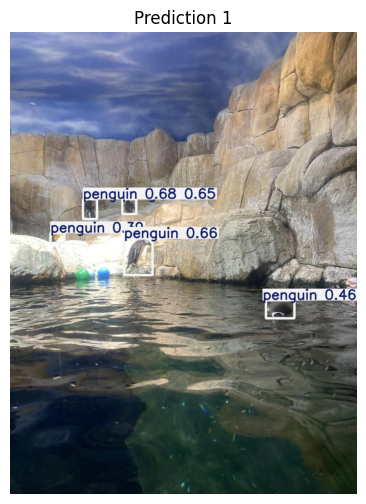

In [127]:
from PIL import Image
import matplotlib.pyplot as plt
import os

saved_folder = "/content/drive/MyDrive/predictions_yolo"

for i, filename in enumerate(sorted(os.listdir(saved_folder))):
    if filename.endswith((".jpg", ".png")):
        img_path = os.path.join(saved_folder, filename)
        img = Image.open(img_path)

        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Prediction {i+1}")
        plt.show()

        if i >= 1:
            break
